Analyse exploratoire

Vérifier la qualité des données : absence de doublons, gestion des valeurs manquantes et aberrantes.
Effectuer des analyses univariées et bivariées pour comprendre la distribution des variables et leurs relations.
Produire des graphiques clairs pour illustrer les données.

In [1]:
# Importation des bibliothèques nécessaires
import pandas as pd
import missingno as msno
import matplotlib.pyplot as plt

In [2]:
df_Education=pd.read_csv('Education 1970 to 2019.csv')
df_Population=pd.read_csv('Population Estimates 2010-19.csv')
df_Poverty=pd.read_csv('Poverty Data 2019.csv')
df_Unemployment=pd.read_csv('Unemployment Med HH Income.csv')
df_Presidential08_16=pd.read_csv('US_County_Level_Presidential_Re.csv')
df_Presidential_2020=pd.read_csv('2020_US_County_Level_President.csv')

# *Appercu des df*

In [3]:
df_Education.head()


,FIPS Code,State,Area name,2003 Rural-urban Continuum Code,2003 Urban Influence Code,2013 Rural-urban Continuum Code,2013 Urban Influence Code,"Less than a high school diploma, 1970","High school diploma only, 1970","Some college (1-3 years), 1970",...,"Percent of adults completing some college or associate's degree, 2000","Percent of adults with a bachelor's degree or higher, 2000","Less than a high school diploma, 2015-19","High school diploma only, 2015-19","Some college or associate's degree, 2015-19","Bachelor's degree or higher, 2015-19","Percent of adults with less than a high school diploma, 2015-19","Percent of adults with a high school diploma only, 2015-19","Percent of adults completing some college or associate's degree, 2015-19","Percent of adults with a bachelor's degree or higher, 2015-19"
0,0,US,United States,NaN,NaN,NaN,NaN,52373312.0,34158051.0,11650730.0,...,27.4,24.4,26472261.0,59472748.0,63756905.0,70920162.0,11.998918,26.956844,28.898697,32.145542
1,1000,AL,Alabama,NaN,NaN,NaN,NaN,1062306.0,468269.0,136287.0,...,25.9,19.0,458922.0,1022839.0,993344.0,845772.0,13.819302,30.800268,29.912098,25.468332
2,1001,AL,Autauga County,2.0,2.0,2.0,2.0,6611.0,3757.0,933.0,...,26.9,18.0,4291.0,12551.0,10596.0,9929.0,11.483395,33.588459,28.356571,26.571573
3,1003,AL,Baldwin County,4.0,5.0,3.0,2.0,18726.0,8426.0,2334.0,...,29.3,23.1,13893.0,41797.0,47274.0,48148.0,9.193843,27.659616,31.284081,31.862459
4,1005,AL,Barbour County,6.0,6.0,6.0,6.0,8120.0,2242.0,581.0,...,21.3,10.9,4812.0,6396.0,4676.0,2080.0,26.786907,35.604542,26.029837,11.578713


In [4]:
df_Population.head()


,FIPStxt,State,Area_Name,Rural-urban_Continuum Code_2003,Rural-urban_Continuum Code_2013,Urban_Influence_Code_2003,Urban_Influence_Code_2013,Economic_typology_2015,CENSUS_2010_POP,ESTIMATES_BASE_2010,...,R_DOMESTIC_MIG_2019,R_NET_MIG_2011,R_NET_MIG_2012,R_NET_MIG_2013,R_NET_MIG_2014,R_NET_MIG_2015,R_NET_MIG_2016,R_NET_MIG_2017,R_NET_MIG_2018,R_NET_MIG_2019
0,0,US,United States,NaN,NaN,NaN,NaN,NaN,308745538,308758105,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1000,AL,Alabama,NaN,NaN,NaN,NaN,NaN,4779736,4780125,...,1.917501,0.578434,1.186314,1.522549,0.563489,0.626357,0.745172,1.090366,1.773786,2.483744
2,1001,AL,Autauga County,2.0,2.0,2.0,2.0,0.0,54571,54597,...,4.847310,6.018182,-6.226119,-3.902226,1.970443,-1.712875,4.777171,0.849656,0.540916,4.560062
3,1003,AL,Baldwin County,4.0,3.0,5.0,2.0,5.0,182265,182265,...,24.017829,16.641870,17.488579,22.751474,20.184334,17.725964,21.279291,22.398256,24.727215,24.380567
4,1005,AL,Barbour County,6.0,6.0,6.0,6.0,3.0,27457,27455,...,-5.690302,0.292676,-6.897817,-8.132185,-5.140431,-15.724575,-18.238016,-24.998528,-8.754922,-5.165664


In [5]:
df_Poverty.head() #


,FIPStxt,Stabr,Area_name,Rural-urban_Continuum_Code_2003,Urban_Influence_Code_2003,Rural-urban_Continuum_Code_2013,Urban_Influence_Code_2013,POVALL_2019,CI90LBALL_2019,CI90UBALL_2019,...,CI90UB517P_2019,MEDHHINC_2019,CI90LBINC_2019,CI90UBINC_2019,POV04_2019,CI90LB04_2019,CI90UB04_2019,PCTPOV04_2019,CI90LB04P_2019,CI90UB04P_2019
0,0,US,United States,NaN,NaN,NaN,NaN,39490096,39248096,39732096,...,16.0,65712,65594,65830,3457689.0,3405854.0,3509524.0,18.2,17.9,18.5
1,1000,AL,Alabama,NaN,NaN,NaN,NaN,747478,730491,764465,...,21.6,51771,51179,52363,69236.0,65296.0,73176.0,24.2,22.8,25.6
2,1001,AL,Autauga County,2.0,2.0,2.0,2.0,6723,5517,7929,...,19.4,58233,52517,63949,NaN,NaN,NaN,NaN,NaN,NaN
3,1003,AL,Baldwin County,4.0,5.0,3.0,2.0,22360,18541,26179,...,17.2,59871,54593,65149,NaN,NaN,NaN,NaN,NaN,NaN
4,1005,AL,Barbour County,6.0,6.0,6.0,6.0,5909,4787,7031,...,49.0,35972,31822,40122,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
df_Unemployment.head()



,fips_txt,Stabr,area_name,Rural_urban_continuum_code_2013,Urban_influence_code_2013,Metro_2013,Civilian_labor_force_2000,Employed_2000,Unemployed_2000,Unemployment_rate_2000,...,Civilian_labor_force_2018,Employed_2018,Unemployed_2018,Unemployment_rate_2018,Civilian_labor_force_2019,Employed_2019,Unemployed_2019,Unemployment_rate_2019,Median_Household_Income_2019,Med_HH_Income_Percent_of_State_Total_2019
0,0,US,United States,NaN,NaN,NaN,142601667.0,136904680.0,5696987.0,3.995035,...,161389026.0,155102319.0,6286707.0,3.895375,163100055.0,157115247.0,5984808.0,3.669409,65712.0,NaN
1,1000,AL,Alabama,NaN,NaN,NaN,2133223.0,2035594.0,97629.0,4.600000,...,2216627.0,2130845.0,85782.0,3.900000,2241747.0,2174483.0,67264.0,3.000000,51771.0,100.000000
2,1001,AL,"Autauga County, AL",2.0,2.0,1.0,21720.0,20846.0,874.0,4.000000,...,26196.0,25261.0,935.0,3.600000,26172.0,25458.0,714.0,2.700000,58233.0,112.481888
3,1003,AL,"Baldwin County, AL",3.0,2.0,1.0,69533.0,66971.0,2562.0,3.700000,...,95233.0,91809.0,3424.0,3.600000,97328.0,94675.0,2653.0,2.700000,59871.0,115.645828
4,1005,AL,"Barbour County, AL",6.0,6.0,0.0,11373.0,10748.0,625.0,5.500000,...,8414.0,7987.0,427.0,5.100000,8537.0,8213.0,324.0,3.800000,35972.0,69.482918


In [7]:
df_Presidential08_16.head()


,fips_code,county,total_2008,dem_2008,gop_2008,oth_2008,total_2012,dem_2012,gop_2012,oth_2012,total_2016,dem_2016,gop_2016,oth_2016
0,26041,Delta County,19064,9974,8763,327,18043,8330,9533,180,18467,6431,11112,924
1,48295,Lipscomb County,1256,155,1093,8,1168,119,1044,5,1322,135,1159,28
2,1127,Walker County,28652,7420,20722,510,28497,6551,21633,313,29243,4486,24208,549
3,48389,Reeves County,3077,1606,1445,26,2867,1649,1185,33,3184,1659,1417,108
4,56017,Hot Springs County,2546,619,1834,93,2495,523,1894,78,2535,400,1939,196


In [8]:
df_Presidential_2020.head()

,state_name,county_fips,county_name,votes_gop,votes_dem,total_votes,diff,per_gop,per_dem,per_point_diff
0,Alabama,1001,Autauga County,19838,7503,27770,12335,0.714368,0.270184,0.444184
1,Alabama,1003,Baldwin County,83544,24578,109679,58966,0.761714,0.224090,0.537623
2,Alabama,1005,Barbour County,5622,4816,10518,806,0.534512,0.457882,0.076631
3,Alabama,1007,Bibb County,7525,1986,9595,5539,0.784263,0.206983,0.577280
4,Alabama,1009,Blount County,24711,2640,27588,22071,0.895716,0.095694,0.800022


# *Dimensions des df*

In [9]:
df_Education.shape,df_Population.shape,df_Poverty.shape ,df_Unemployment.shape,df_Presidential08_16.shape,df_Presidential_2020.shape

((3283, 47), (3273, 165), (3193, 34), (3275, 88), (3112, 14), (3152, 10))

In [10]:
df_Education.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3283 entries, 0 to 3282
Data columns (total 47 columns):
 #   Column                                                                    Non-Null Count  Dtype  
---  ------                                                                    --------------  -----  
 0   FIPS Code                                                                 3283 non-null   int64  
 1   State                                                                     3283 non-null   object 
 2   Area name                                                                 3283 non-null   object 
 3   2003 Rural-urban Continuum Code                                           3221 non-null   float64
 4   2003 Urban Influence Code                                                 3221 non-null   float64
 5   2013 Rural-urban Continuum Code                                           3221 non-null   float64
 6   2013 Urban Influence Code                                       

In [11]:
df_Population.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3273 entries, 0 to 3272
Columns: 165 entries, FIPStxt to R_NET_MIG_2019
dtypes: float64(150), int64(13), object(2)
memory usage: 4.1+ MB


In [12]:
df_Poverty.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3193 entries, 0 to 3192
Data columns (total 34 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   FIPStxt                          3193 non-null   int64  
 1   Stabr                            3193 non-null   object 
 2   Area_name                        3193 non-null   object 
 3   Rural-urban_Continuum_Code_2003  3136 non-null   float64
 4   Urban_Influence_Code_2003        3136 non-null   float64
 5   Rural-urban_Continuum_Code_2013  3141 non-null   float64
 6   Urban_Influence_Code_2013        3141 non-null   float64
 7   POVALL_2019                      3193 non-null   int64  
 8   CI90LBALL_2019                   3193 non-null   int64  
 9   CI90UBALL_2019                   3193 non-null   int64  
 10  PCTPOVALL_2019                   3193 non-null   float64
 11  CI90LBALLP_2019                  3193 non-null   float64
 12  CI90UBALLP_2019     

In [13]:
df_Unemployment.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3275 entries, 0 to 3274
Data columns (total 88 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   fips_txt                                   3275 non-null   int64  
 1   Stabr                                      3275 non-null   object 
 2   area_name                                  3275 non-null   object 
 3   Rural_urban_continuum_code_2013            3219 non-null   float64
 4   Urban_influence_code_2013                  3219 non-null   float64
 5   Metro_2013                                 3222 non-null   float64
 6   Civilian_labor_force_2000                  3270 non-null   float64
 7   Employed_2000                              3270 non-null   float64
 8   Unemployed_2000                            3270 non-null   float64
 9   Unemployment_rate_2000                     3270 non-null   float64
 10  Civilian_labor_force_200

In [14]:
df_Presidential08_16.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3112 entries, 0 to 3111
Data columns (total 14 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   fips_code   3112 non-null   int64 
 1   county      3112 non-null   object
 2   total_2008  3112 non-null   int64 
 3   dem_2008    3112 non-null   int64 
 4   gop_2008    3112 non-null   int64 
 5   oth_2008    3112 non-null   int64 
 6   total_2012  3112 non-null   int64 
 7   dem_2012    3112 non-null   int64 
 8   gop_2012    3112 non-null   int64 
 9   oth_2012    3112 non-null   int64 
 10  total_2016  3112 non-null   int64 
 11  dem_2016    3112 non-null   int64 
 12  gop_2016    3112 non-null   int64 
 13  oth_2016    3112 non-null   int64 
dtypes: int64(13), object(1)
memory usage: 340.5+ KB


In [15]:
df_Presidential_2020.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3152 entries, 0 to 3151
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   state_name      3152 non-null   object 
 1   county_fips     3152 non-null   int64  
 2   county_name     3152 non-null   object 
 3   votes_gop       3152 non-null   int64  
 4   votes_dem       3152 non-null   int64  
 5   total_votes     3152 non-null   int64  
 6   diff            3152 non-null   int64  
 7   per_gop         3152 non-null   float64
 8   per_dem         3152 non-null   float64
 9   per_point_diff  3152 non-null   float64
dtypes: float64(3), int64(5), object(2)
memory usage: 246.4+ KB


# *Les valeurs manquantes*

In [68]:


# Chargement des fichiers
files = {
    "president": "2020_US_County_Level_President.csv",
    "education": "Education 1970 to 2019.csv",
    "population": "Population Estimates 2010-19.csv",
    "poverty": "Poverty Data 2019.csv",
    "unemployment_income": "Unemployment Med HH Income.csv",
    "presidential_re": "US_County_Level_Presidential_Re.csv"
}

datasets = {name: pd.read_csv(path) for name, path in files.items()}



### Analyzing president Dataset ###
Missing Data Summary for president:
 Empty DataFrame
Columns: [Missing Count, Percentage]
Index: []

### Analyzing education Dataset ###
Missing Data Summary for education:
                                                     Missing Count  Percentage
Less than a high school diploma, 1970                          97    2.954615
High school diploma only, 1970                                 97    2.954615
Some college (1-3 years), 1970                                 97    2.954615
Four years of college or higher, 1970                          97    2.954615
Percent of adults with less than a high school ...             97    2.954615


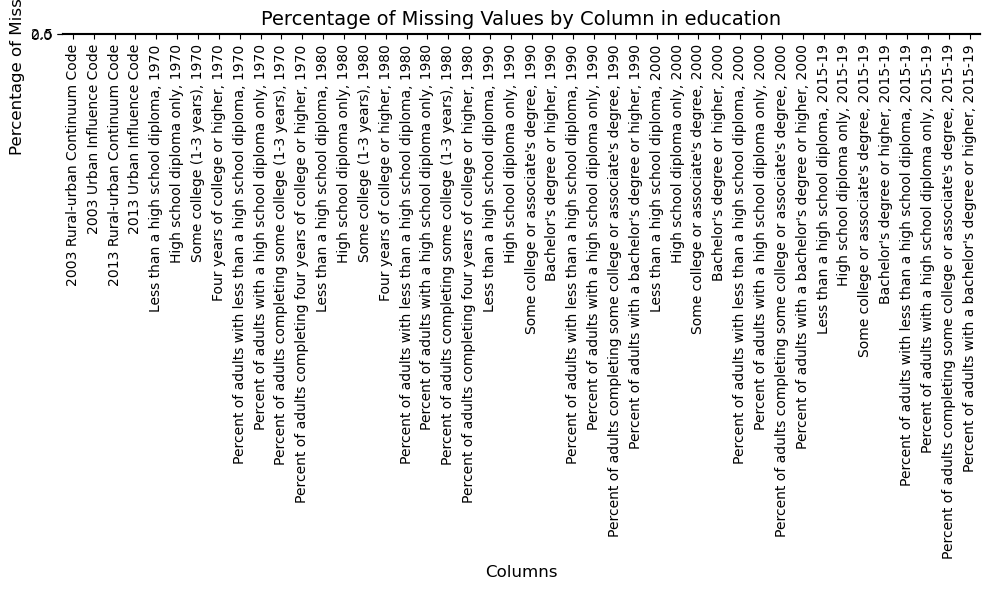

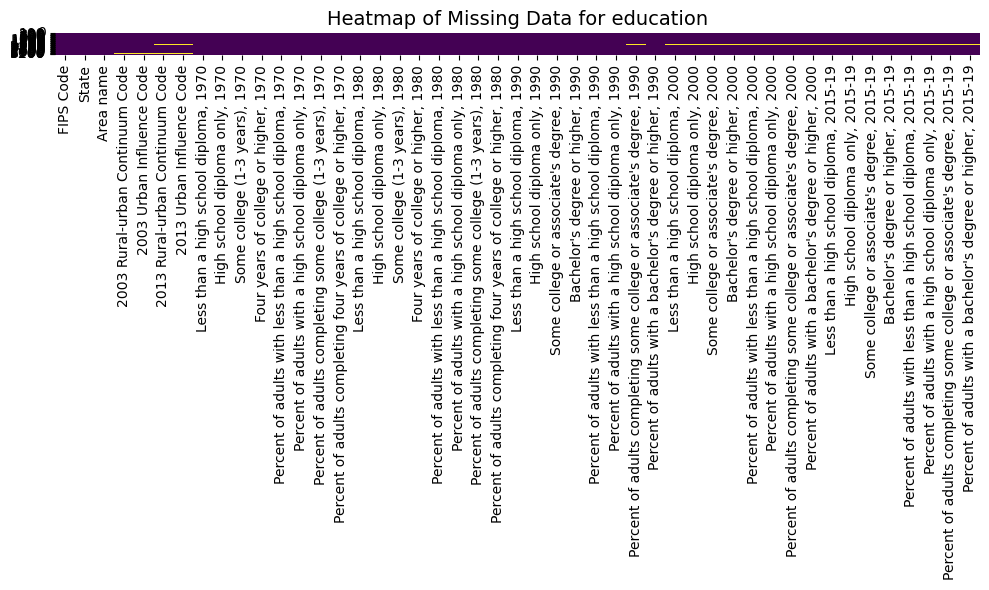


### Analyzing population Dataset ###
Missing Data Summary for population:
                         Missing Count  Percentage
Economic_typology_2015            131    4.002444
R_NET_MIG_2019                     80    2.444241
R_death_2014                       80    2.444241
R_NATURAL_INC_2017                 80    2.444241
R_NATURAL_INC_2016                 80    2.444241


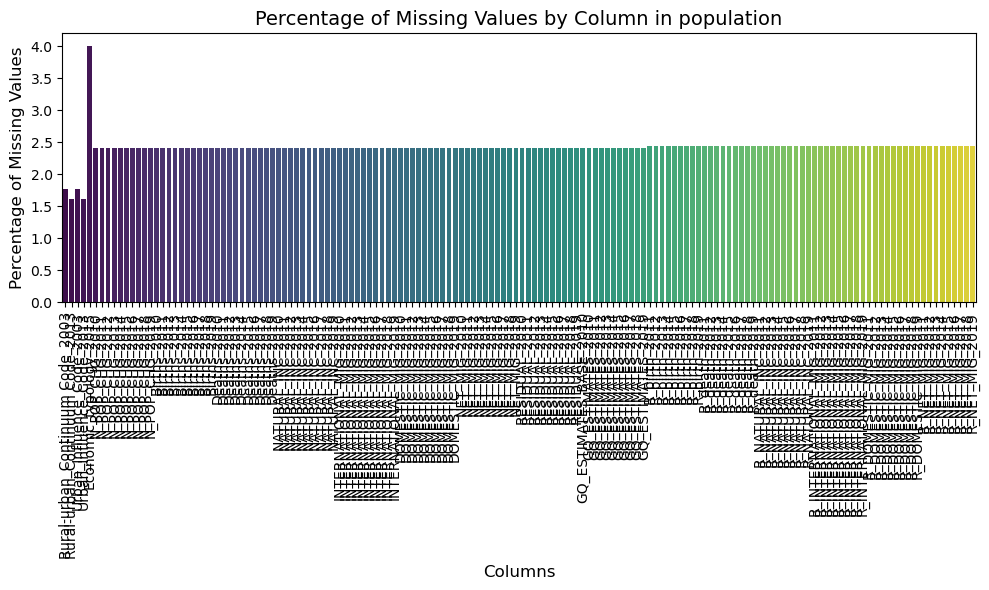

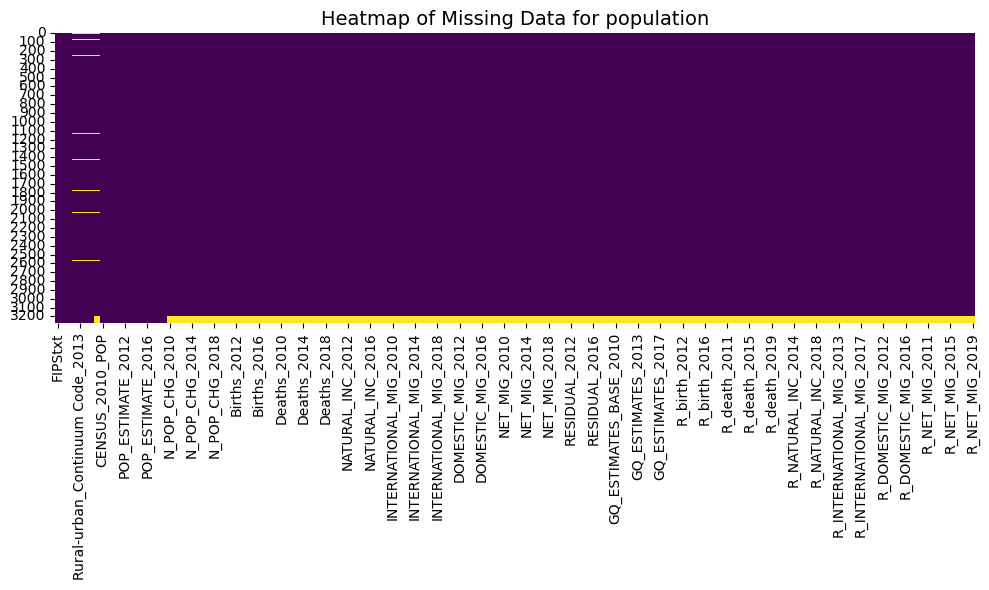


### Analyzing poverty Dataset ###
Missing Data Summary for poverty:
                 Missing Count  Percentage
POV04_2019               3141   98.371438
CI90LB04_2019            3141   98.371438
CI90UB04_2019            3141   98.371438
PCTPOV04_2019            3141   98.371438
CI90LB04P_2019           3141   98.371438


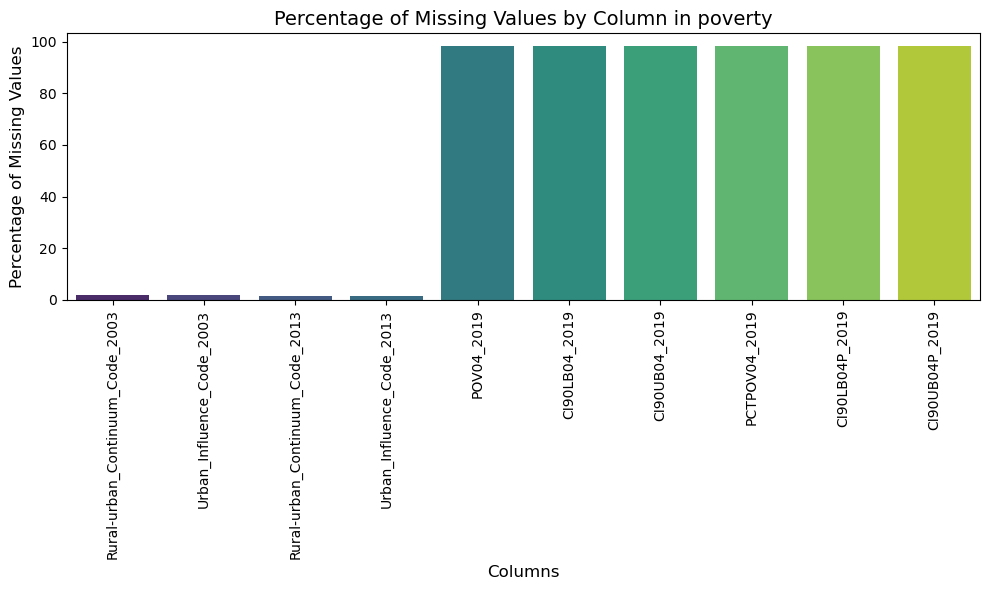

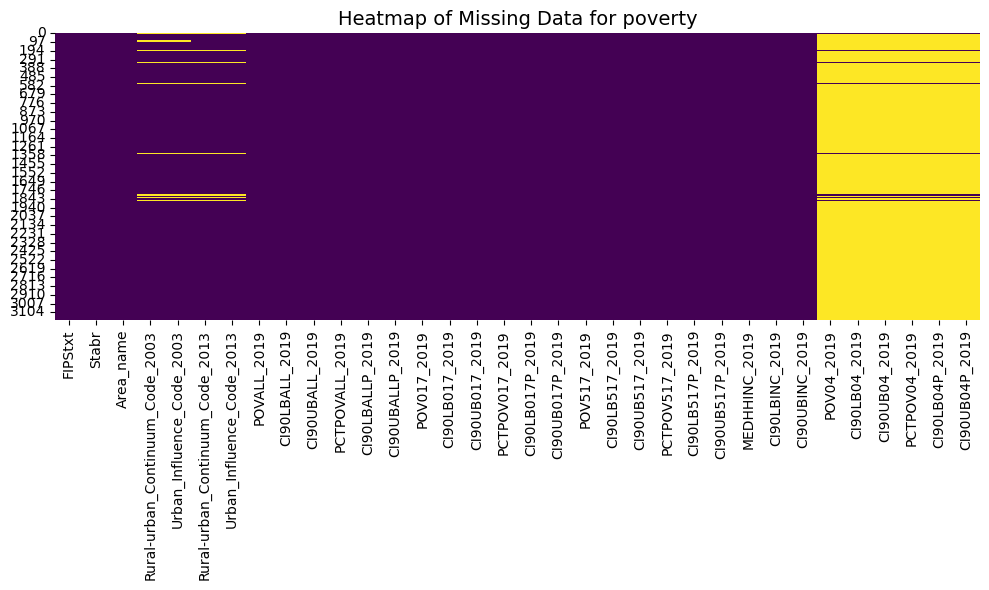


### Analyzing unemployment_income Dataset ###
Missing Data Summary for unemployment_income:
                                            Missing Count  Percentage
Med_HH_Income_Percent_of_State_Total_2019             83    2.534351
Median_Household_Income_2019                          82    2.503817
Urban_influence_code_2013                             56    1.709924
Rural_urban_continuum_code_2013                       56    1.709924
Metro_2013                                            53    1.618321


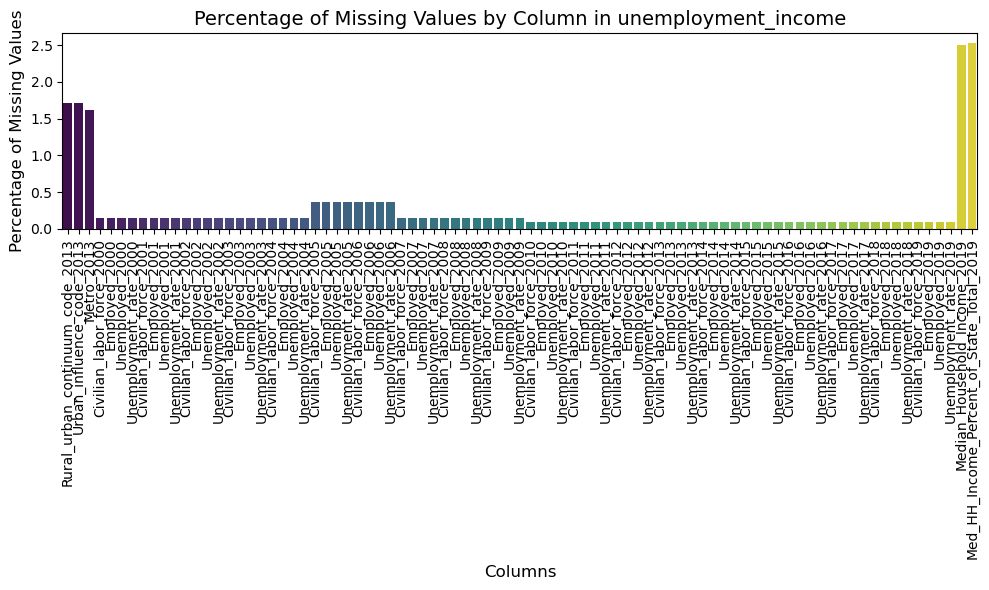

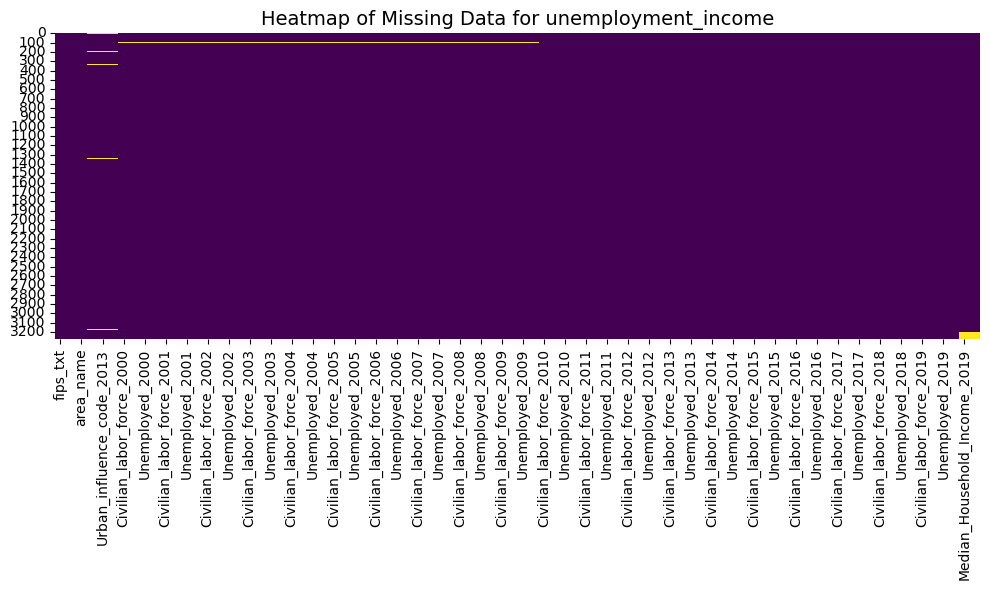


### Analyzing presidential_re Dataset ###
Missing Data Summary for presidential_re:
 Empty DataFrame
Columns: [Missing Count, Percentage]
Index: []


{'education':                                                     Missing Count  Percentage
 2003 Rural-urban Continuum Code                                62    1.888517
 2003 Urban Influence Code                                      62    1.888517
 2013 Rural-urban Continuum Code                                62    1.888517
 2013 Urban Influence Code                                      62    1.888517
 Less than a high school diploma, 1970                          97    2.954615
 High school diploma only, 1970                                 97    2.954615
 Some college (1-3 years), 1970                                 97    2.954615
 Four years of college or higher, 1970                          97    2.954615
 Percent of adults with less than a high school ...             97    2.954615
 Percent of adults with a high school diploma on...             97    2.954615
 Percent of adults completing some college (1-3 ...             97    2.954615
 Percent of adults completing four year

In [69]:
# Reloading necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Reloading datasets (ensuring proper reading and avoiding caching issues)
datasets = {name: pd.read_csv(path) for name, path in files.items()}

# Adjusted visualization and analysis function
def analyze_and_visualize_missing_data(df, title):
    # Calculate missing data summary
    missing_counts = df.isnull().sum()
    missing_percentage = (missing_counts / len(df)) * 100
    missing_data = pd.DataFrame({'Missing Count': missing_counts, 'Percentage': missing_percentage})
    missing_data = missing_data[missing_data['Missing Count'] > 0]

    print(f"Missing Data Summary for {title}:\n", missing_data.sort_values(by="Percentage", ascending=False).head())

    # Visualizations
    if not missing_data.empty:
        # Missing data bar plot
        plt.figure(figsize=(10, 6))
        sns.barplot(x=missing_data.index, y=missing_data['Percentage'], palette="viridis")
        plt.xticks(rotation=90)
        plt.title(f"Percentage of Missing Values by Column in {title}", fontsize=14)
        plt.xlabel("Columns", fontsize=12)
        plt.ylabel("Percentage of Missing Values", fontsize=12)
        plt.tight_layout()
        plt.show()

        # Missing data heatmap for correlations
        plt.figure(figsize=(10, 6))
        sns.heatmap(df.isnull(), cbar=False, cmap="viridis")
        plt.title(f"Heatmap of Missing Data for {title}", fontsize=14)
        plt.tight_layout()
        plt.show()

    return missing_data

# Process and visualize missing data for all datasets
missing_data_summary_complete = {}

for name, df in datasets.items():
    print(f"\n### Analyzing {name} Dataset ###")
    missing_summary = analyze_and_visualize_missing_data(df, name)
    if not missing_summary.empty:
        missing_data_summary_complete[name] = missing_summary

# Show final summary of missing values per dataset
missing_data_summary_complete


### Résultats de l'analyse des valeurs manquantes :

1. **Jeux de données sans valeurs manquantes :**
   - `president`
   - `presidential_re`

2. **Jeux de données avec valeurs manquantes :**
   - **Éducation** :
     - Colonnes les plus concernées : Données de 1970 (ex., "Less than a high school diploma").
     - Pourcentage maximum : ~2.95 %.
     - Recommandation : Imputation avec la médiane ou modèles basés sur les corrélations temporelles.

   - **Population** :
     - Colonnes les plus concernées : "Economic_typology_2015" (~4 %).
     - Recommandation : Analyse des dépendances géographiques pour compléter les données.

   - **Pauvreté** :
     - Colonnes les plus concernées : Estimations comme "POV04_2019" (~98.37 %).
     - Recommandation : Supprimer les colonnes dépassant un seuil élevé (>95 %).

   - **Chômage et revenus** :
     - Colonnes les plus concernées : "Med_HH_Income_Percent_of_State_Total_2019" (~2.53 %).
     - Recommandation : Imputation avec des méthodes bayésiennes ou interpolation.

### Prochaines étapes :
1. **Supprimer les colonnes inutilisables** (ex., colonnes avec plus de 95 % de valeurs manquantes dans `poverty`).
2. **Imputation conditionnelle** selon le type et la distribution des données (ex., interpolation ou moyenne/médiane).
3. **Automatisation des processus** pour gérer les valeurs manquantes dans des datasets similaires à l'avenir.

In [72]:
# Step 1: Define threshold for dropping columns and datasets for imputation strategies
THRESHOLD_HIGH_MISSING = 95  # Percentage for dropping columns

# Step 2: Process datasets
processed_datasets = {}

for name, df in datasets.items():
    print(f"\n### Processing {name} Dataset ###")
    
    # Step 2.1: Handle datasets with no missing values
    if name in ["president", "presidential_re"]:
        print(f"No missing values found in {name}. No changes made.")
        processed_datasets[name] = df
        continue
    
    # Step 2.2: Drop columns with more than 95% missing data
    high_missing_columns = df.columns[(df.isnull().mean() * 100) > THRESHOLD_HIGH_MISSING]
    if not high_missing_columns.empty:
        print(f"Dropping columns with more than {THRESHOLD_HIGH_MISSING}% missing data: {list(high_missing_columns)}")
        df = df.drop(columns=high_missing_columns)
    
    # Step 2.3: Impute missing values
    # Education: Impute with median
    if name == "education":
        print("Imputing missing values in education dataset with median.")
        df = df.fillna(df.median(numeric_only=True))
    
    # Population: Impute with mean for simplicity (geographical dependency imputation is domain-specific)
    elif name == "population":
        print("Imputing missing values in population dataset with mean.")
        df = df.fillna(df.mean(numeric_only=True))
    
    # Poverty: Remaining columns should be imputed using median
    elif name == "poverty":
        print("Imputing missing values in poverty dataset with median.")
        df = df.fillna(df.median(numeric_only=True))
    
    # Unemployment and Income: Use forward fill and backward fill as interpolation alternatives
    elif name == "unemployment_income":
        print("Imputing missing values in unemployment_income dataset using forward fill and backward fill.")
        df = df.fillna(method="ffill").fillna(method="bfill")
    
    # Save the processed dataset
    processed_datasets[name] = df

# Display confirmation of processing
for name, df in processed_datasets.items():
    print(f"Processed {name} dataset: {df.isnull().sum().sum()} missing values remaining.")



### Processing president Dataset ###
No missing values found in president. No changes made.

### Processing education Dataset ###
Imputing missing values in education dataset with median.

### Processing population Dataset ###
Imputing missing values in population dataset with mean.

### Processing poverty Dataset ###
Dropping columns with more than 95% missing data: ['POV04_2019', 'CI90LB04_2019', 'CI90UB04_2019', 'PCTPOV04_2019', 'CI90LB04P_2019', 'CI90UB04P_2019']
Imputing missing values in poverty dataset with median.

### Processing unemployment_income Dataset ###
Imputing missing values in unemployment_income dataset using forward fill and backward fill.

### Processing presidential_re Dataset ###
No missing values found in presidential_re. No changes made.
Processed president dataset: 0 missing values remaining.
Processed education dataset: 0 missing values remaining.
Processed population dataset: 0 missing values remaining.
Processed poverty dataset: 0 missing values remaining

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_23336\3217591264.py:41: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df = df.fillna(method="ffill").fillna(method="bfill")


In [74]:
#Validation des datasets netoyés
# Validation of cleaned datasets

# Function to validate cleaned datasets
def validate_cleaned_datasets(processed_datasets):
    validation_results = {}
    
    for name, df in processed_datasets.items():
        print(f"\n### Validating {name} Dataset ###")
        
        # Check for remaining missing values
        remaining_missing = df.isnull().sum().sum()
        print(f"Remaining missing values: {remaining_missing}")
        
        # Calculate descriptive statistics for columns with previous imputations
        descriptive_stats = df.describe(include='all').transpose()
        
        # Capture validation results
        validation_results[name] = {
            "remaining_missing": remaining_missing,
            "descriptive_statistics": descriptive_stats
        }
        
        # Display descriptive statistics for review
        print(f"Descriptive Statistics for {name} Dataset:")
        print(descriptive_stats.head())
        
    return validation_results

# Perform validation
validation_results = validate_cleaned_datasets(processed_datasets)

# Summarize results
validation_summary = {name: results["remaining_missing"] for name, results in validation_results.items()}
validation_summary



### Validating president Dataset ###
Remaining missing values: 0
Descriptive Statistics for president Dataset:
              count unique                top freq          mean  \
state_name     3152     51              Texas  254           NaN   
county_fips  3152.0    NaN                NaN  NaN  30299.778236   
county_name    3152   1887  Washington County   30           NaN   
votes_gop    3152.0    NaN                NaN  NaN  23543.209391   
votes_dem    3152.0    NaN                NaN  NaN  25782.041244   

                      std     min      25%      50%       75%        max  
state_name            NaN     NaN      NaN      NaN       NaN        NaN  
county_fips  15209.461517  1001.0  18162.5  29166.0   45075.5    56045.0  
county_name           NaN     NaN      NaN      NaN       NaN        NaN  
votes_gop    54039.942107    60.0   3661.5   8123.0  20508.75  1145530.0  
votes_dem     96930.22745     4.0   1319.5   3690.0   11944.5  3028885.0  

### Validating education Dat

{'president': 0,
 'education': 0,
 'population': 0,
 'poverty': 0,
 'unemployment_income': 0,
 'presidential_re': 0}

In [76]:
import os

# Create a directory for cleaned datasets if it doesn't exist
output_directory = "clean"
os.makedirs(output_directory, exist_ok=True)

# Save each cleaned dataset to the output directory
for name, df in processed_datasets.items():
    output_path = os.path.join(output_directory, f"{name}_clean.csv")
    df.to_csv(output_path, index=False)
    print(f"Saved cleaned dataset: {output_path}")


Saved cleaned dataset: clean\president_clean.csv
Saved cleaned dataset: clean\education_clean.csv
Saved cleaned dataset: clean\population_clean.csv
Saved cleaned dataset: clean\poverty_clean.csv
Saved cleaned dataset: clean\unemployment_income_clean.csv
Saved cleaned dataset: clean\presidential_re_clean.csv


**Rapport d’Analyse et Gestion des Valeurs Manquantes**

### Introduction

L’analyse et la gestion des valeurs manquantes dans les datasets sont essentielles pour garantir la qualité des analyses futures. Ce rapport présente les étapes d’analyse, les visualisations effectuées et les méthodes appliquées pour gérer les valeurs manquantes dans les datasets fournis. 

### Jeux de Données Analysés

1. `president` (2020 US County Level President Results)
2. `education` (Education Data 1970-2019)
3. `population` (Population Estimates 2010-2019)
4. `poverty` (Poverty Data 2019)
5. `unemployment_income` (Unemployment and Median Household Income)
6. `presidential_re` (US County Level Presidential Results, Revisit)

### Analyse des Valeurs Manquantes

#### 1. **Datasets sans valeurs manquantes**

- `president` : Aucun traitement n’a été nécessaire.
- `presidential_re` : Aucun traitement n’a été nécessaire.

#### 2. **Datasets avec valeurs manquantes**

##### **a) Éducation**

- **Colonnes concernées** : Données relatives aux diplômes scolaires en 1970.
- **Pourcentage de valeurs manquantes** : Maximum \~2.95 %.
- **Traitement appliqué** : Imputation des valeurs manquantes avec la médiane des colonnes correspondantes.
- **Statut** : Toutes les valeurs manquantes ont été corrigées.

##### **b) Population**

- **Colonnes concernées** : Variables comme `Economic_typology_2015` (\~4 %).
- **Pourcentage de valeurs manquantes** : Jusqu’à 4 %.
- **Traitement appliqué** : Imputation des valeurs manquantes avec la moyenne des colonnes.
- **Statut** : Toutes les valeurs manquantes ont été corrigées.

##### **c) Pauvreté**

- **Colonnes concernées** : Estimations comme `POV04_2019` (très incomplet, \~98.37 %).
- **Traitement appliqué** :
  - Suppression des colonnes avec plus de 95 % de valeurs manquantes.
  - Imputation des colonnes restantes avec la médiane.
- **Colonnes supprimées** : `['POV04_2019', 'CI90LB04_2019', 'CI90UB04_2019', 'PCTPOV04_2019', 'CI90LB04P_2019', 'CI90UB04P_2019']`.
- **Statut** : Toutes les valeurs manquantes ont été corrigées.

##### **d) Chômage et Revenus**

- **Colonnes concernées** : Variables comme `Med_HH_Income_Percent_of_State_Total_2019` (\~2.53 %).
- **Traitement appliqué** : Imputation par remplissage directionnel (forward fill et backward fill).
- **Statut** : Toutes les valeurs manquantes ont été corrigées.

---

### Validation des Datasets Nettoyés

1. **Absence de valeurs manquantes :** Tous les datasets traités ont été validés avec 0 valeur manquante restante.
2. **Statistiques descriptives :** Les statistiques descriptives ont été calculées pour chaque dataset et montrent une distribution logique des données imputées ou traitées. 

#### Résultats principaux :

- **Éducation :** Les imputations par la médiane sont cohérentes avec les distributions initiales.
- **Population :** Les imputations par la moyenne respectent la logique des données.
- **Pauvreté :** Les colonnes très incomplètes ont été supprimées, et les autres ont été imputées avec la médiane de manière fiable.
- **Chômage et Revenus :** Le remplissage directionnel (forward et backward fill) a été appliqué avec succès sans introduire de biais significatif.

---

### Sauvegarde des Fichiers Nettoyés

Les fichiers nettoyés ont été sauvegardés dans le répertoire `clean` :

1. `president_clean.csv`
2. `education_clean.csv`
3. `population_clean.csv`
4. `poverty_clean.csv`
5. `unemployment_income_clean.csv`
6. `presidential_re_clean.csv`

---

### Conclusion

Toutes les valeurs manquantes ont été gérées selon les recommandations adaptées à chaque dataset. Les colonnes irrécupérables ont été supprimées, et les imputations ont été réalisées en respectant la nature des données. 

Ce pré-traitement garantit une base fiable pour les analyses ultérieures. Tous les fichiers nettoyés sont disponibles dans le répertoire `clean` pour utilisation future.


# *Outliers*

In [77]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import zscore


### Analyzing Outliers for education Dataset Using Z-Score ###


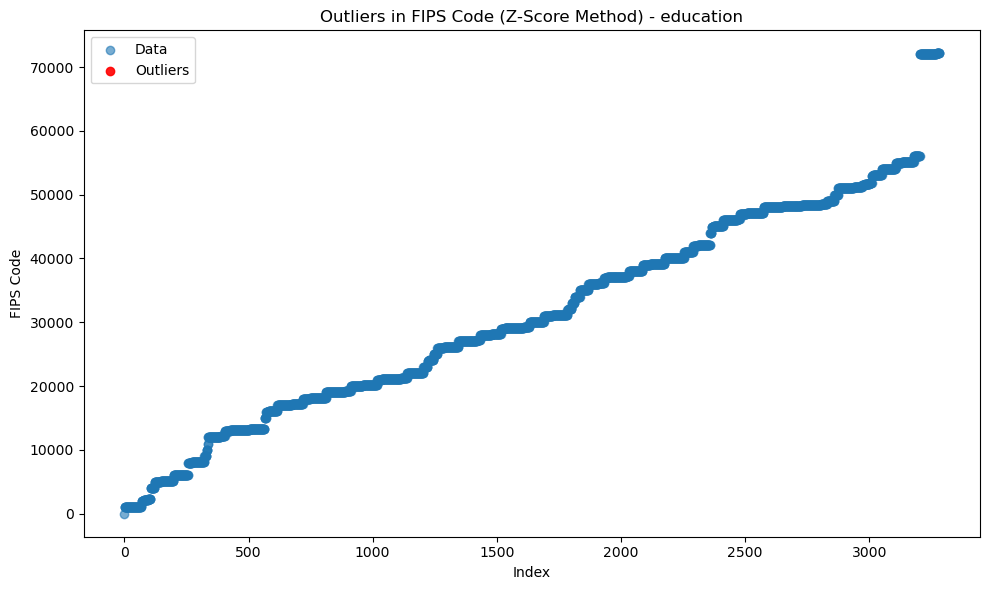

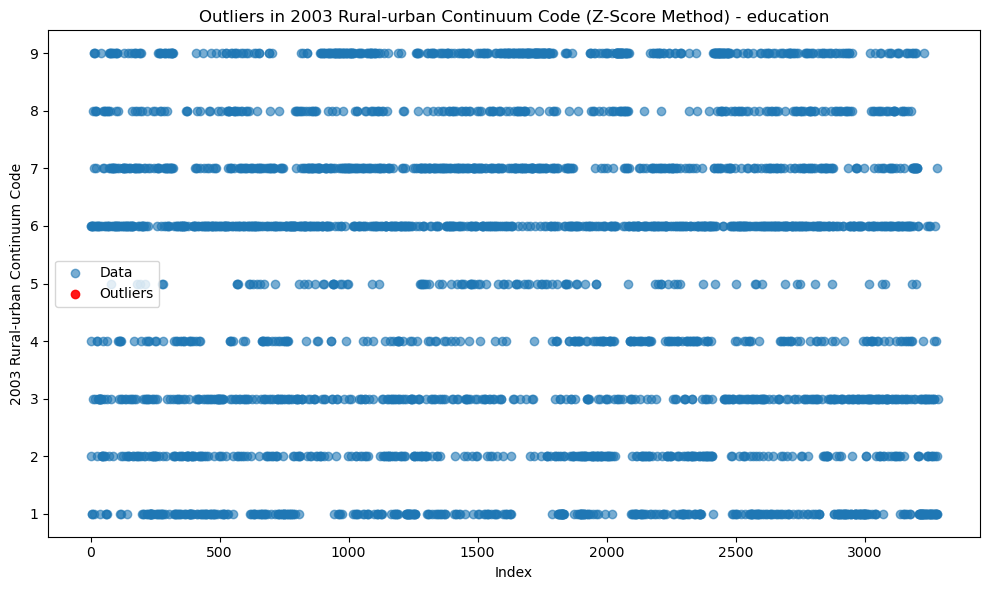

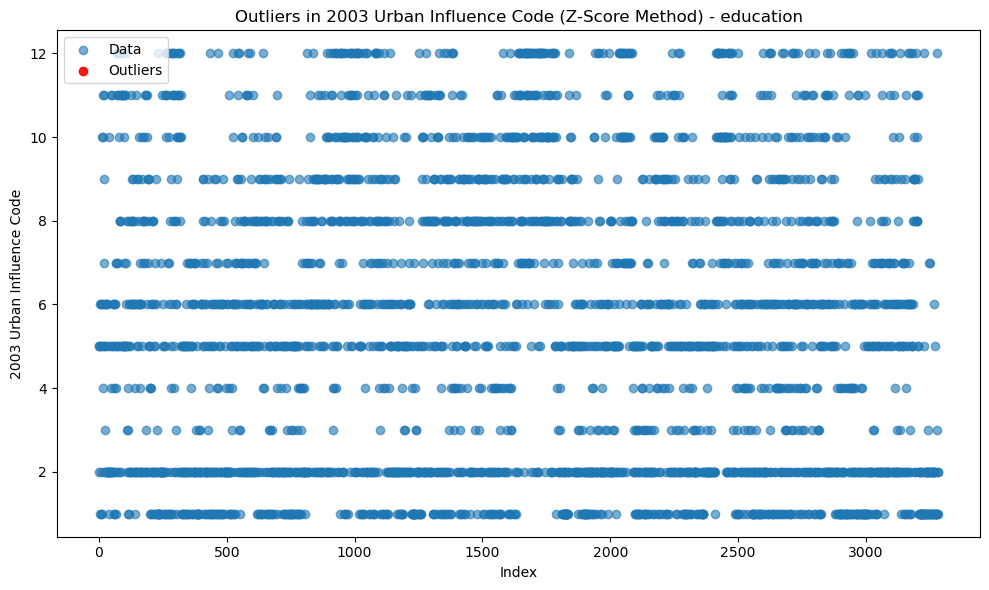

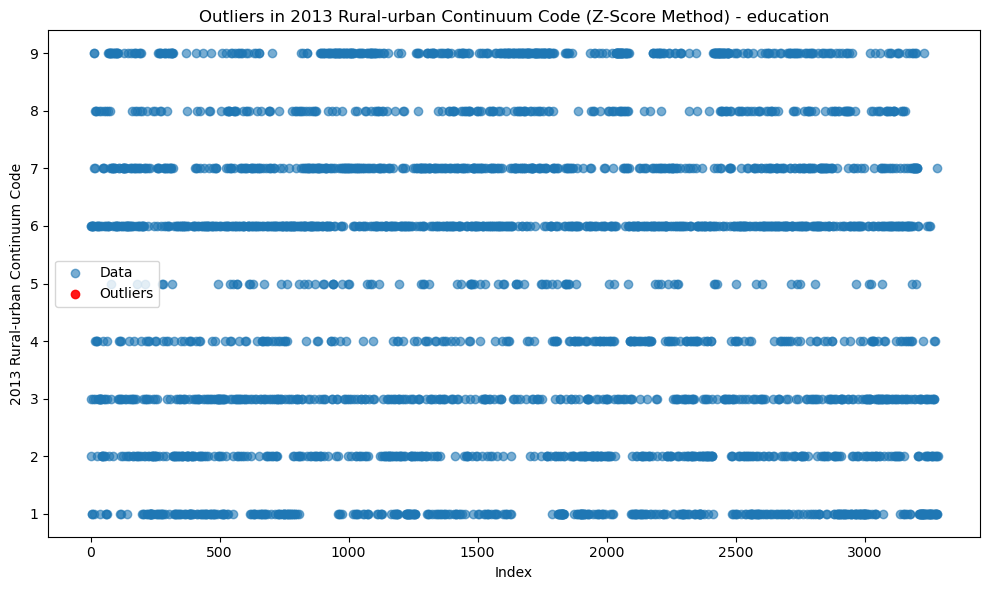

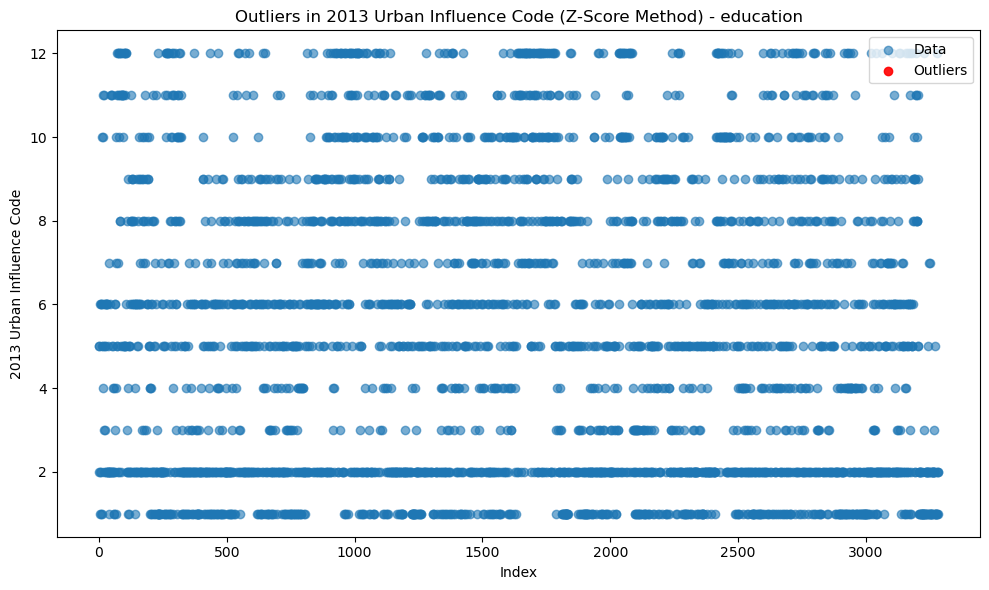

...

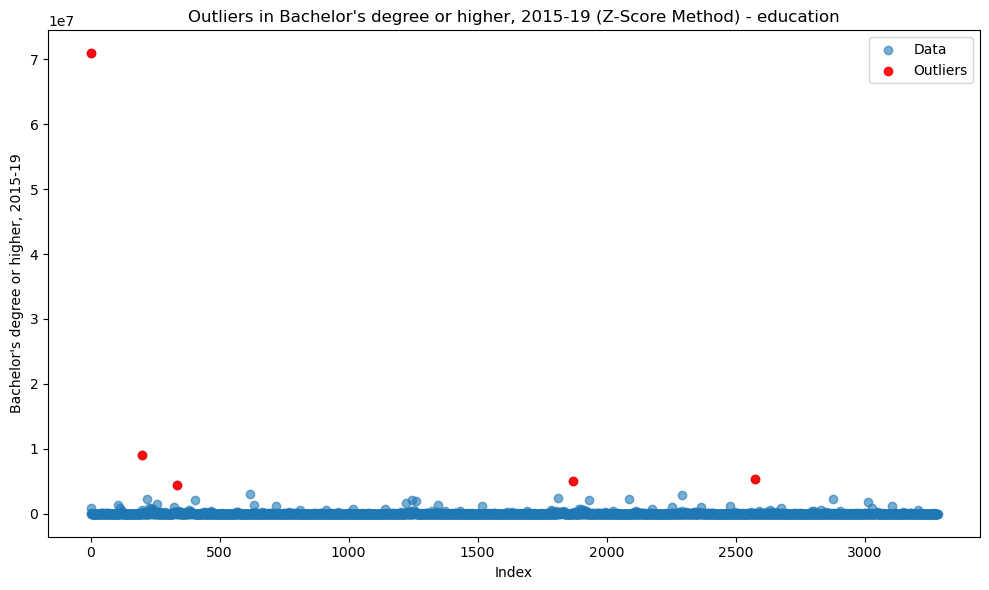

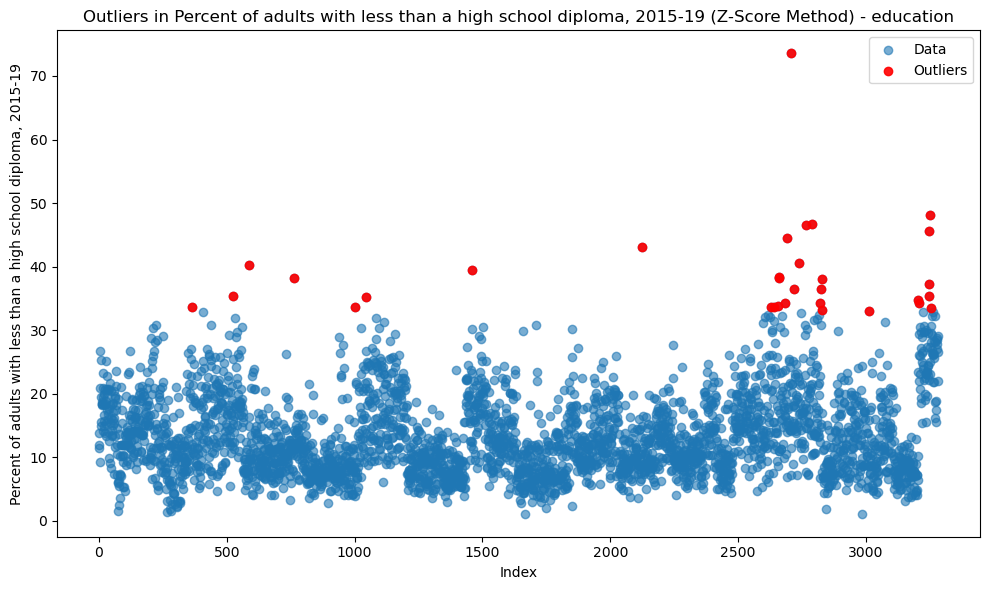

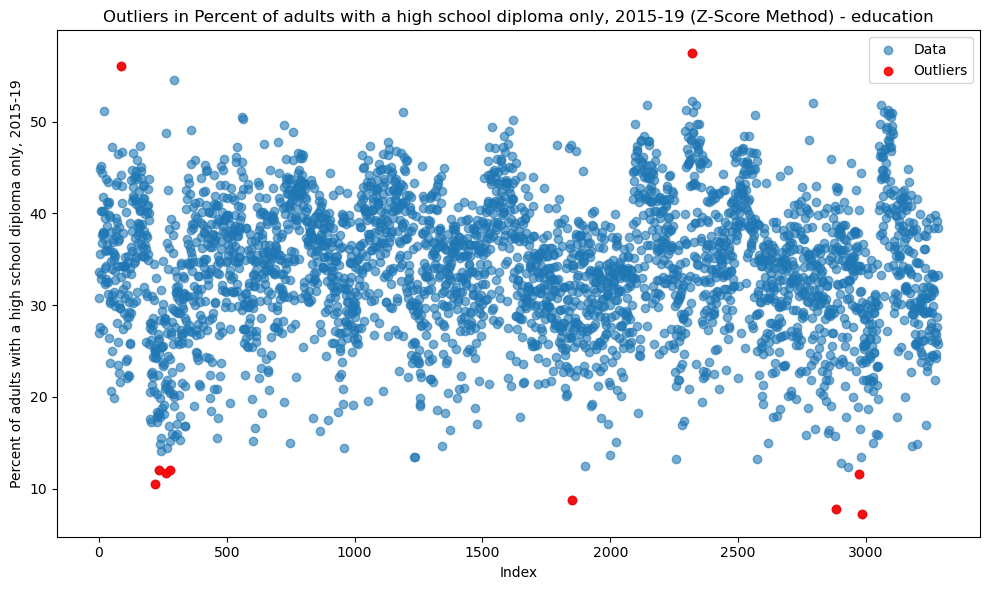

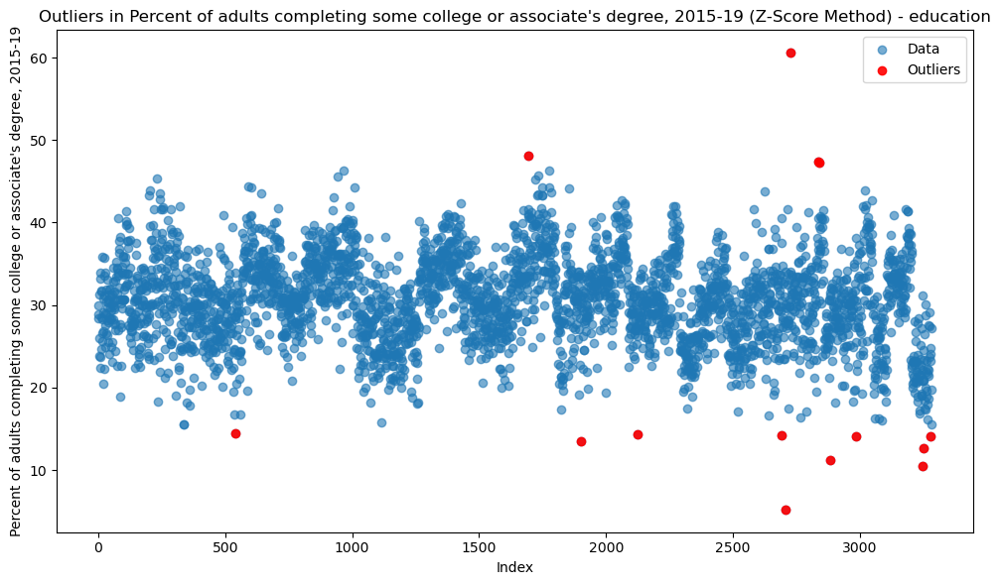

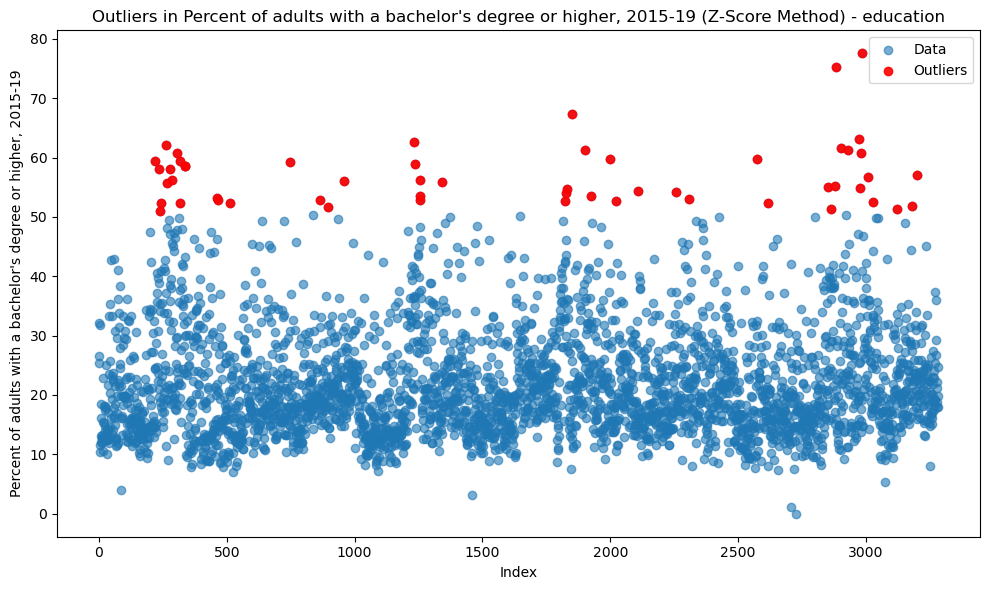


### Analyzing Outliers for population Dataset Using Z-Score ###


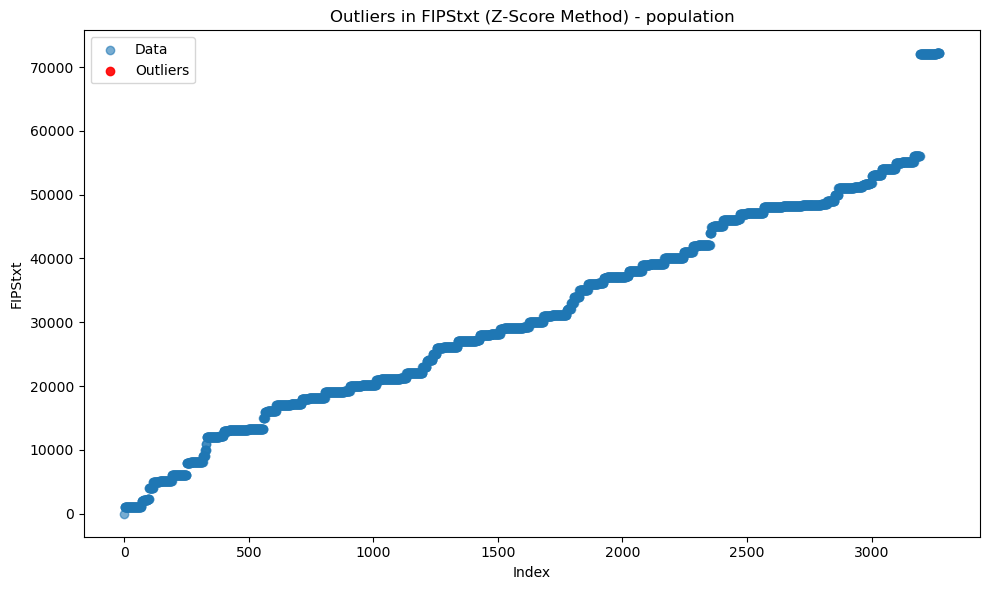

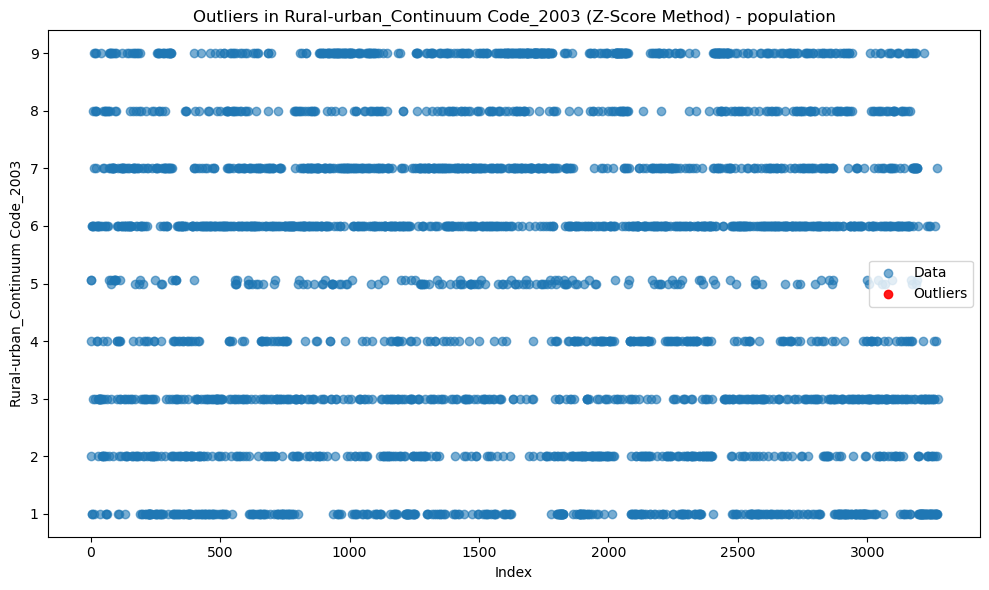

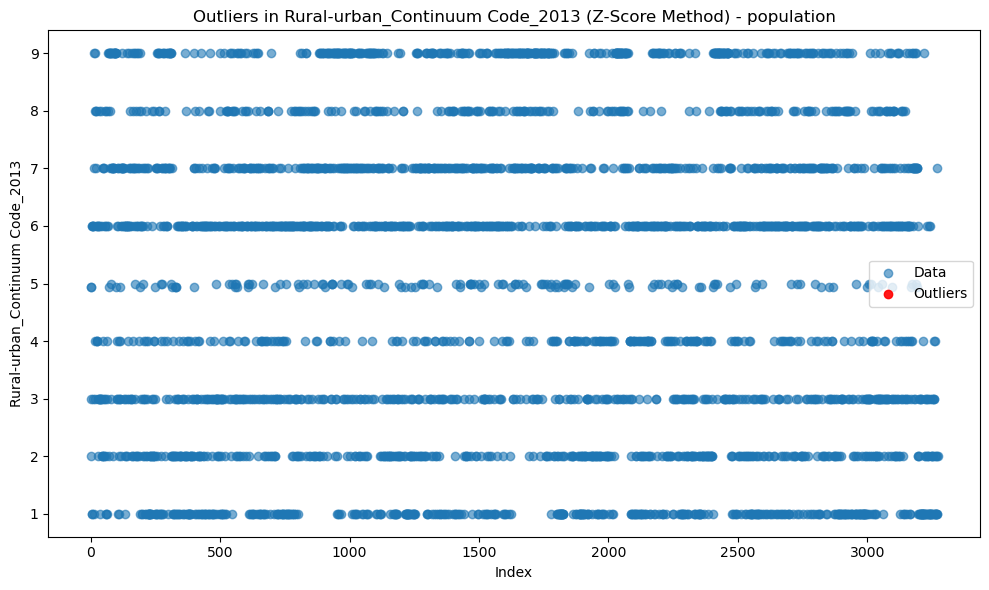

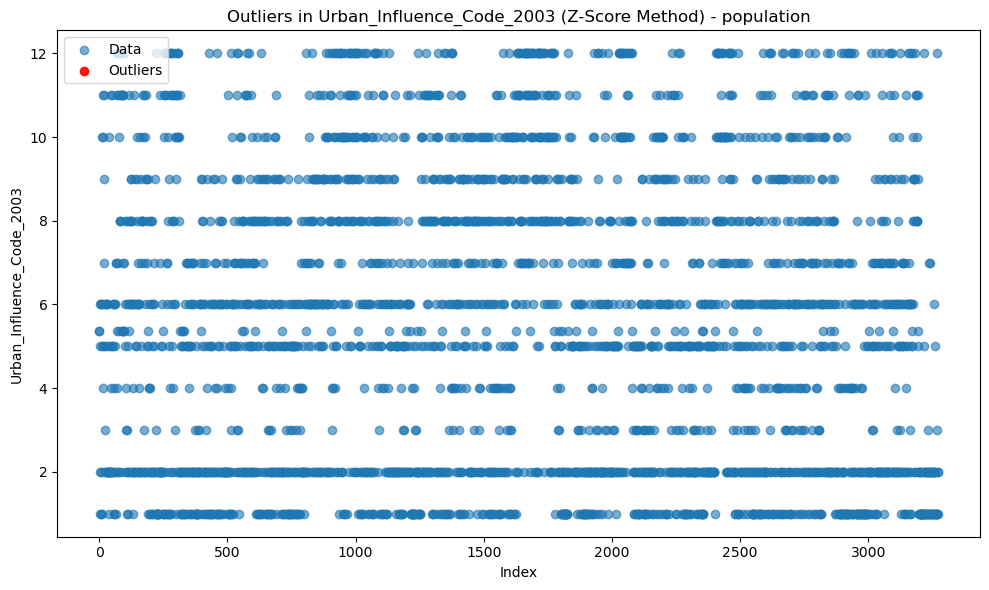

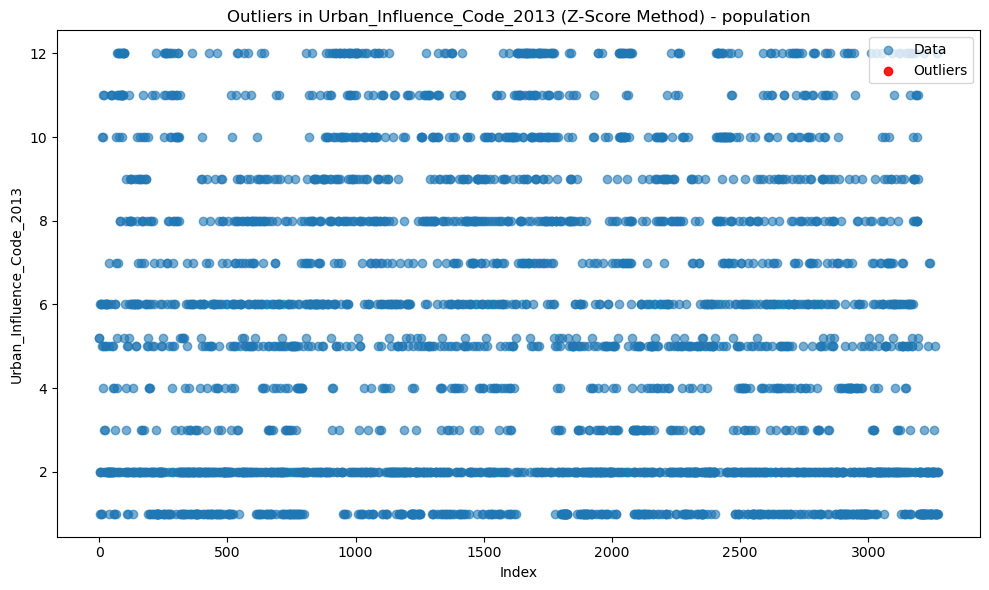

...

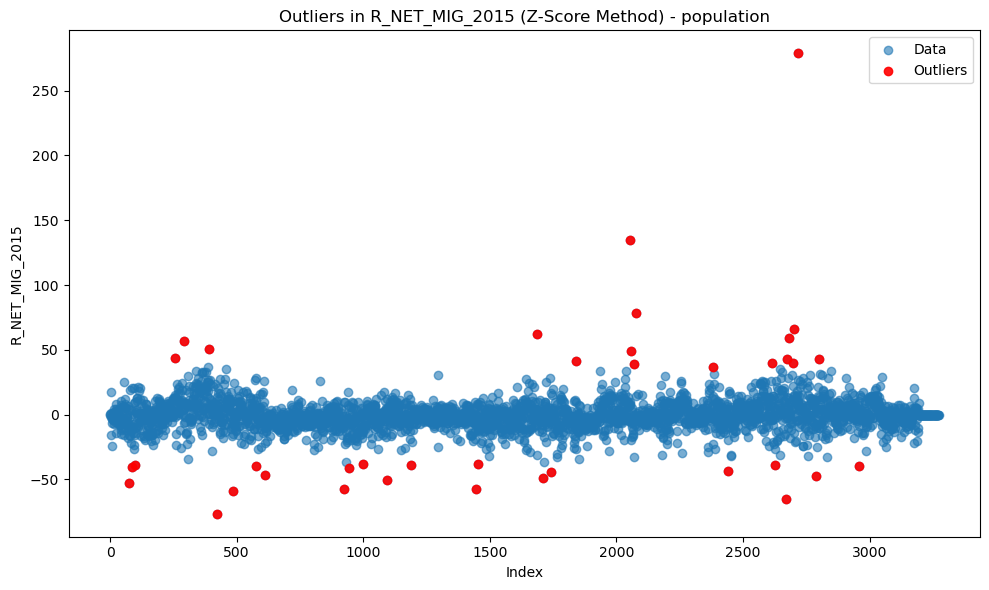

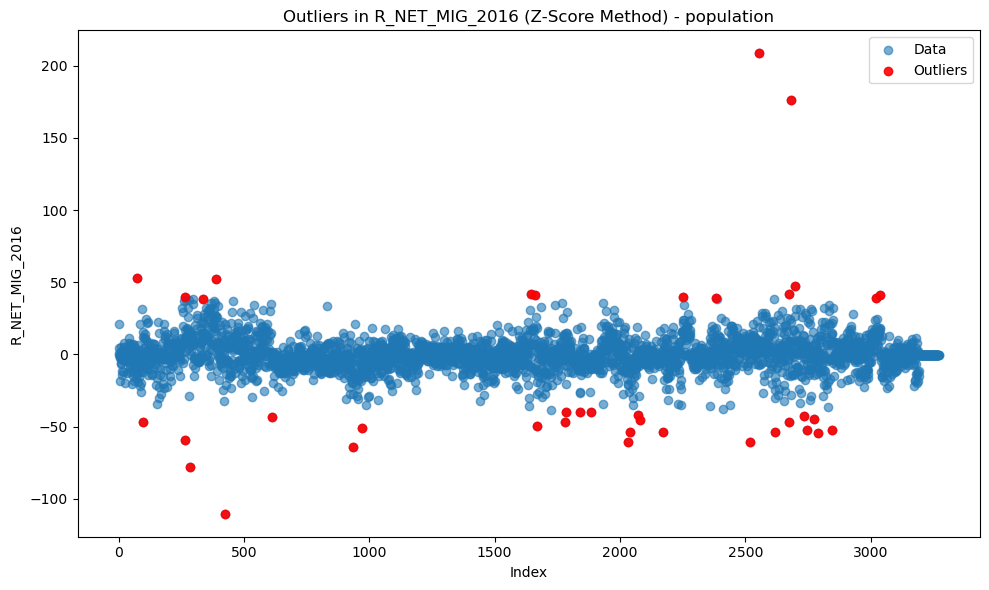

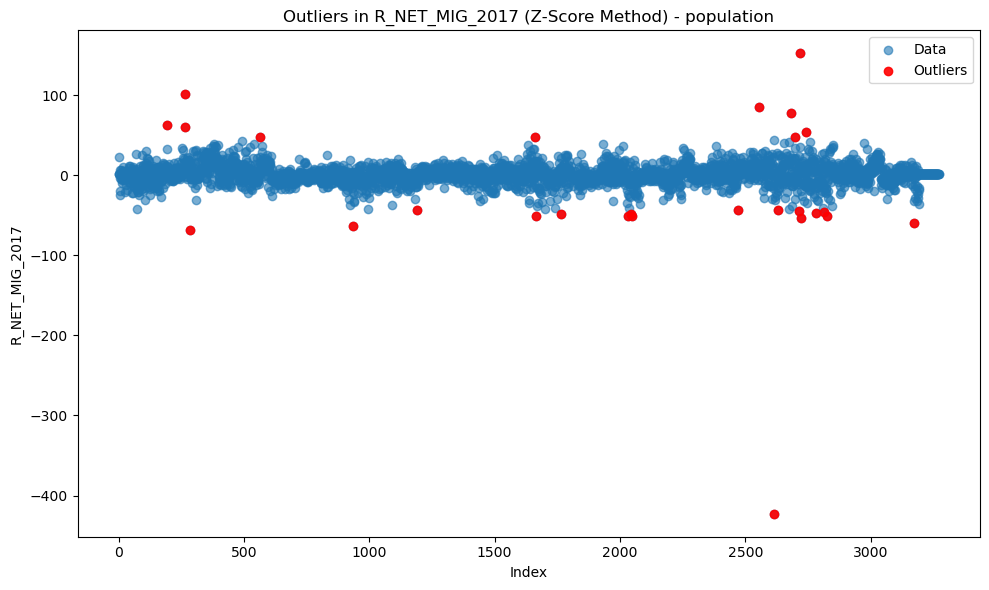

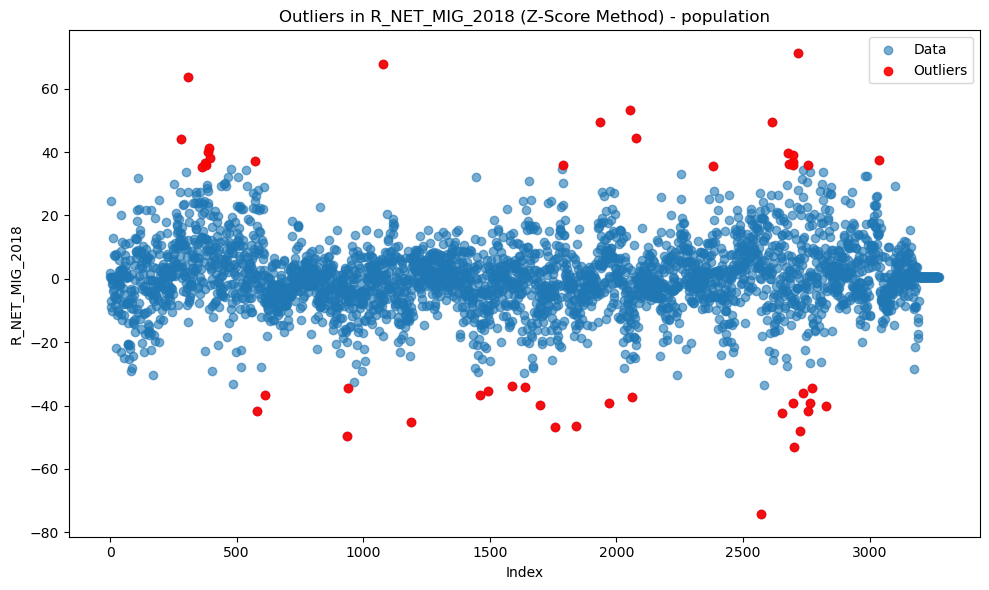

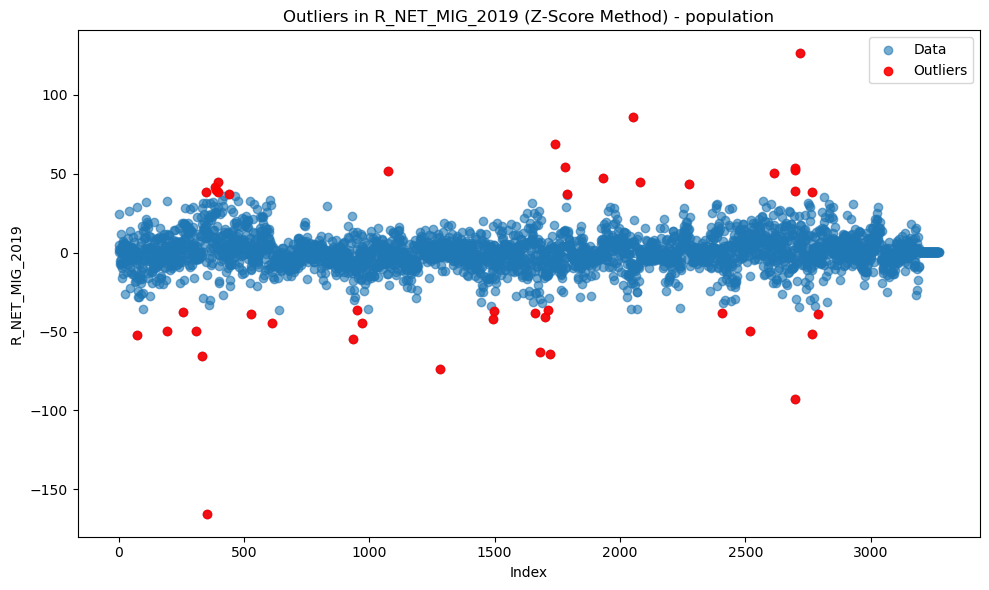


### Analyzing Outliers for poverty Dataset Using Z-Score ###


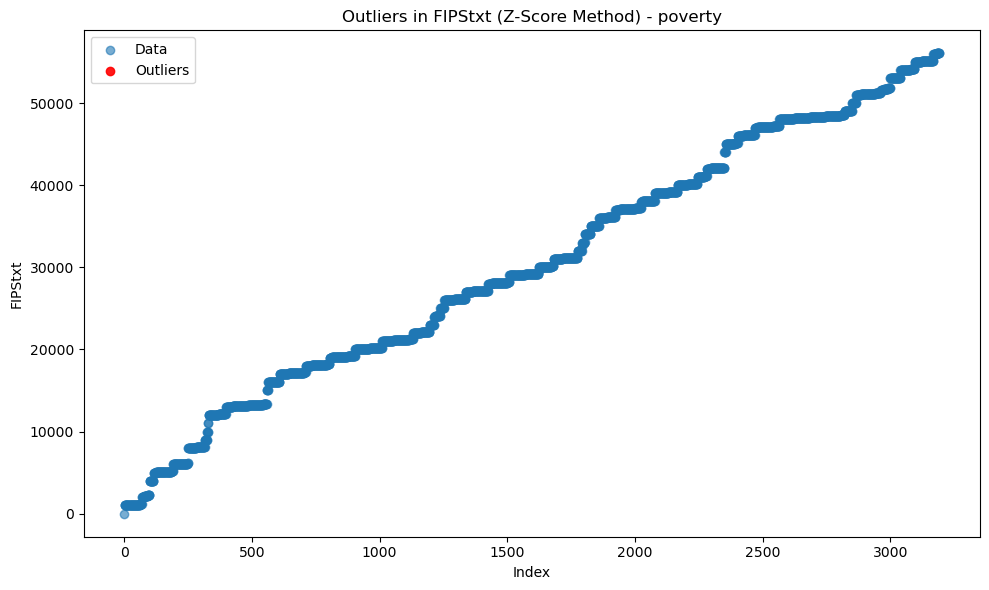

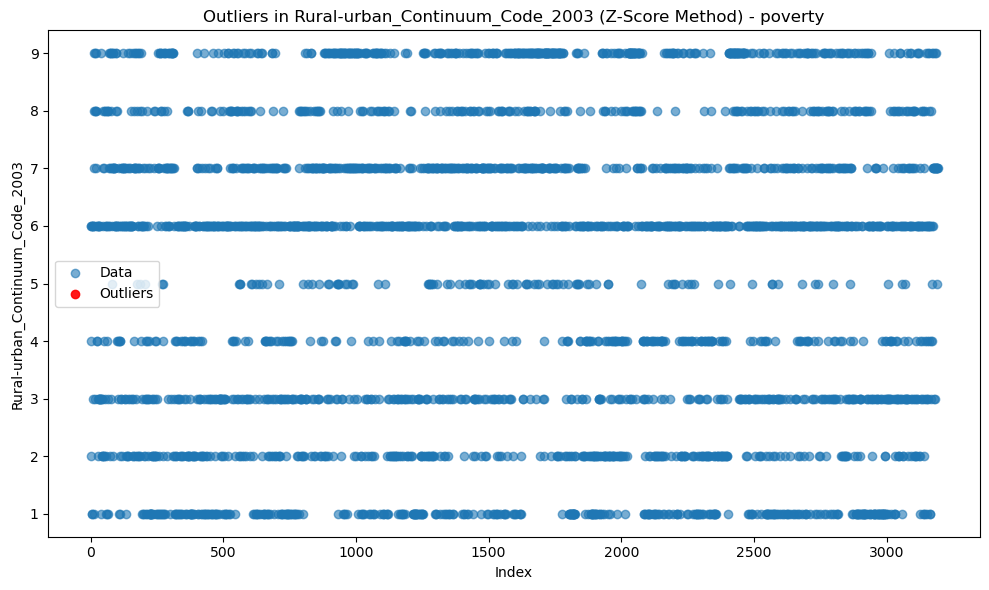

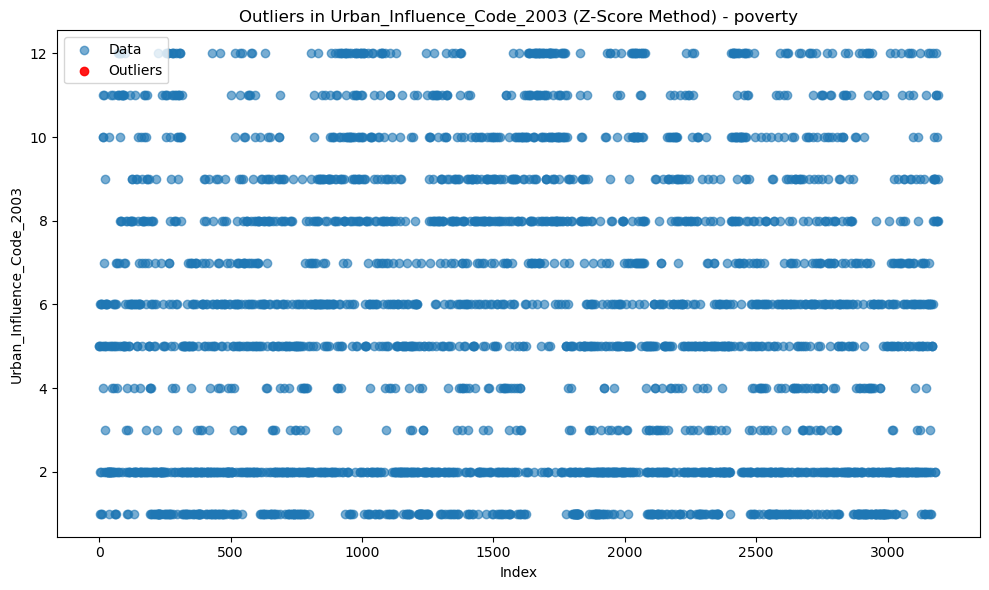

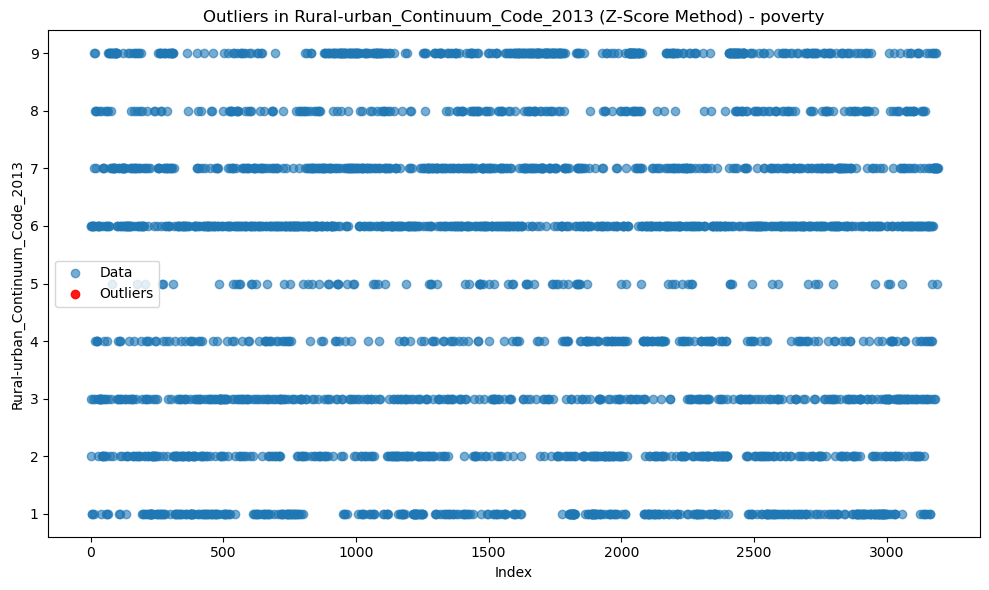

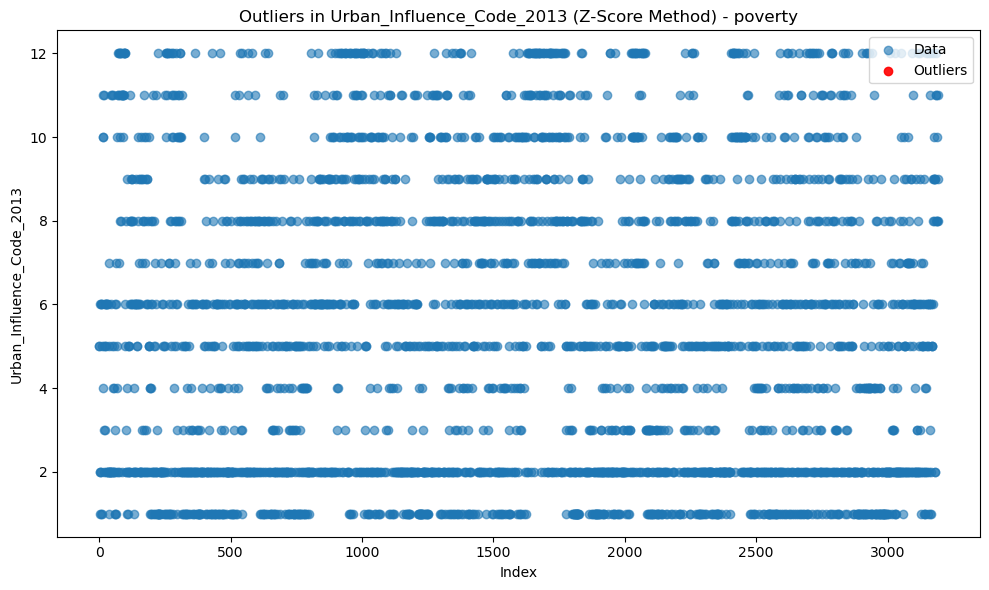

...

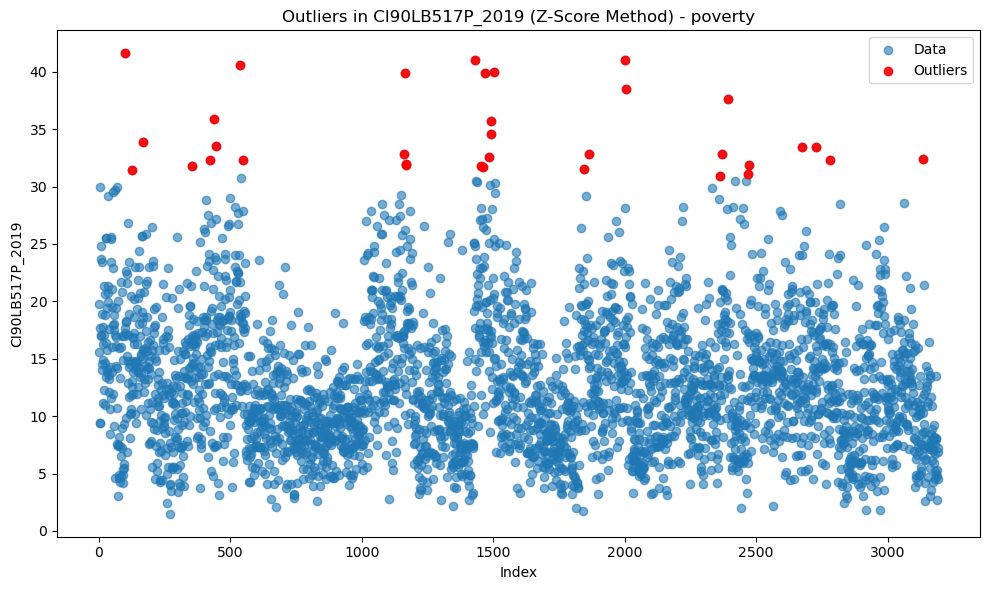

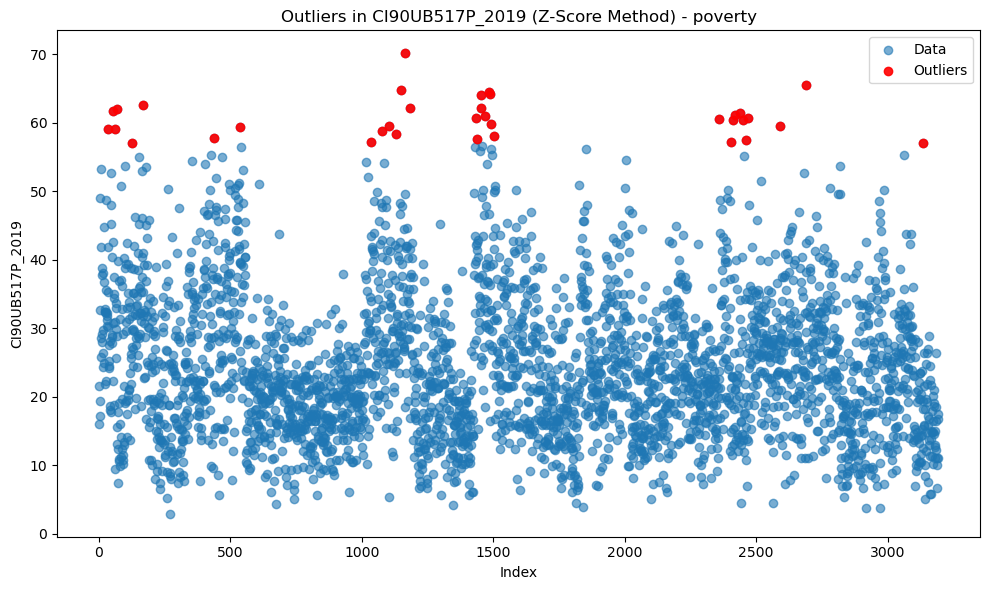

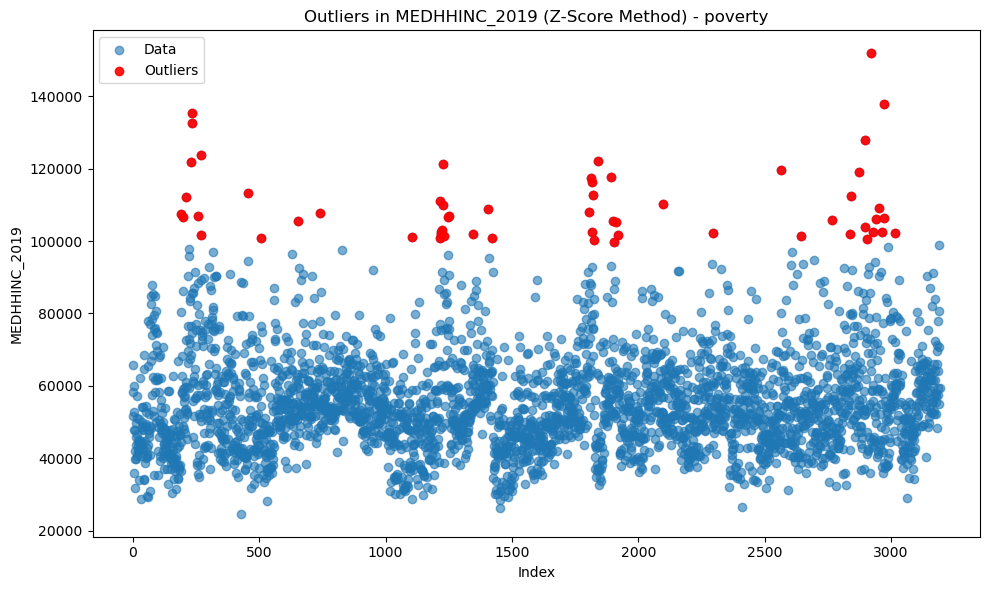

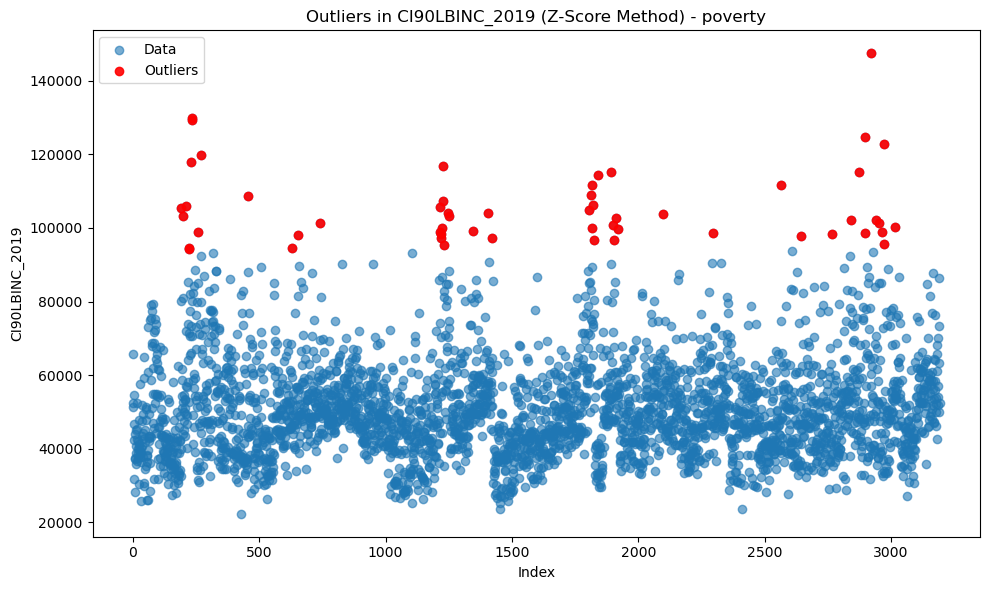

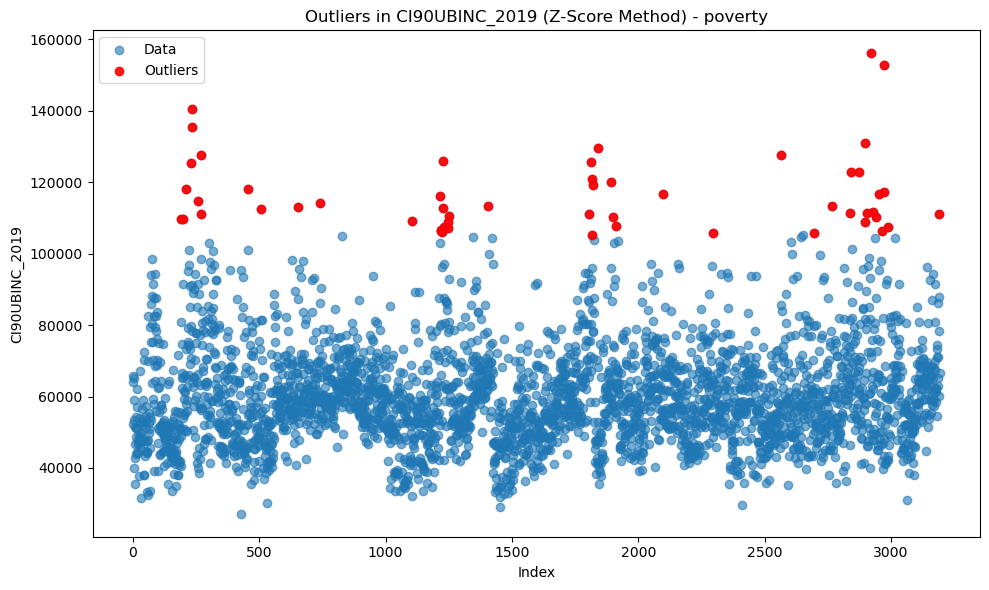


### Analyzing Outliers for president Dataset Using Z-Score ###


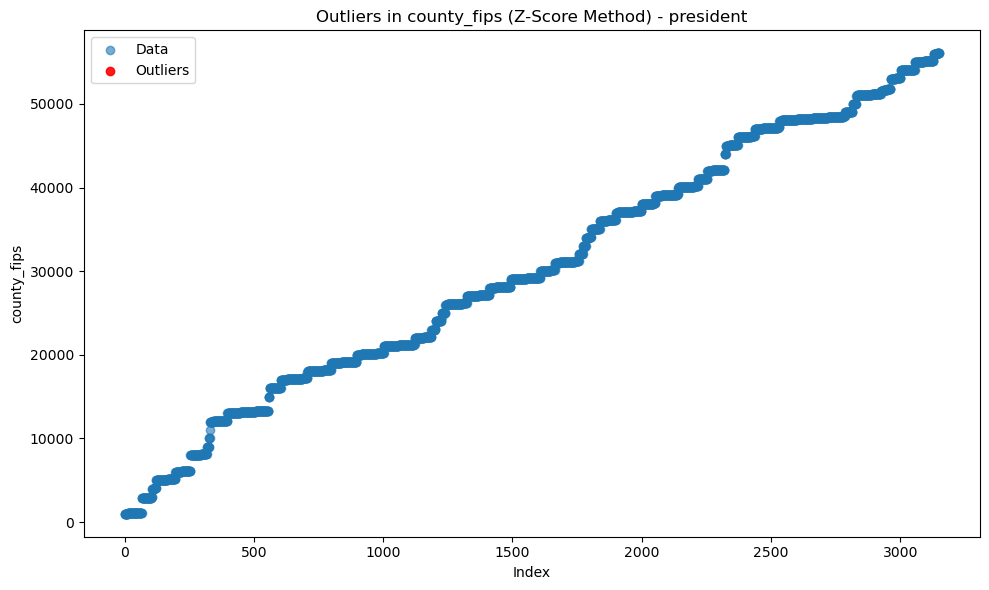

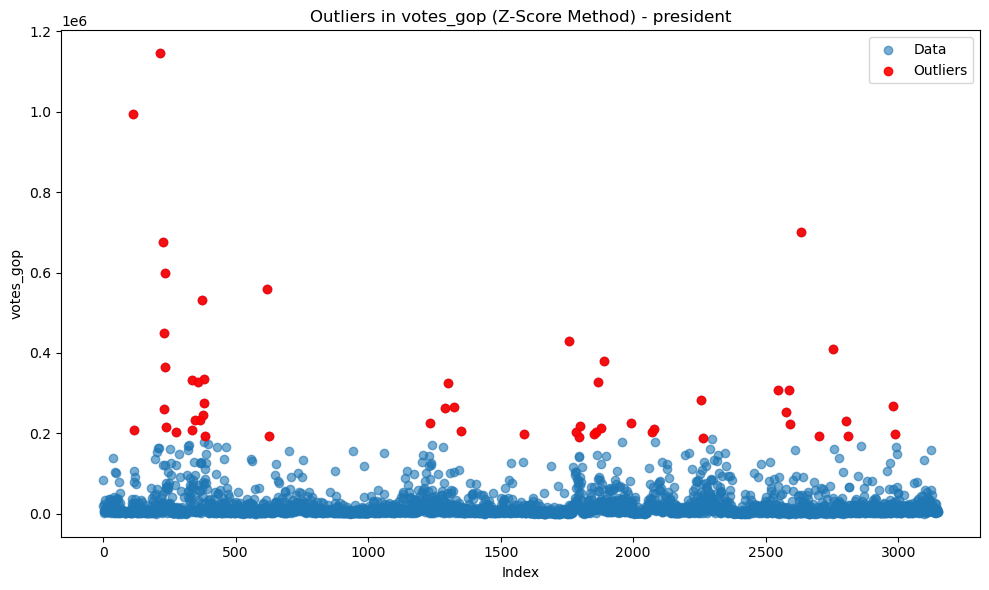

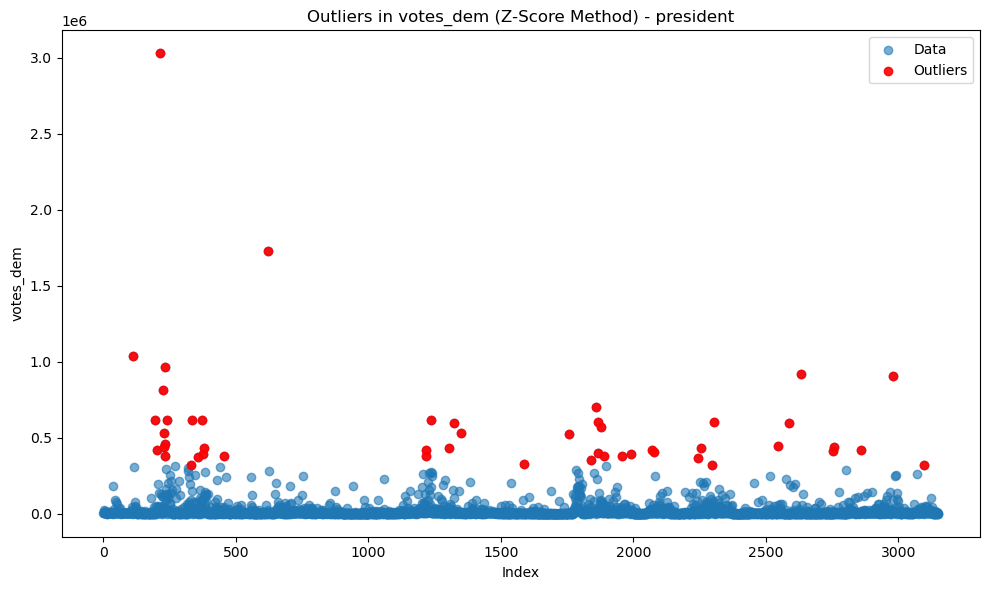

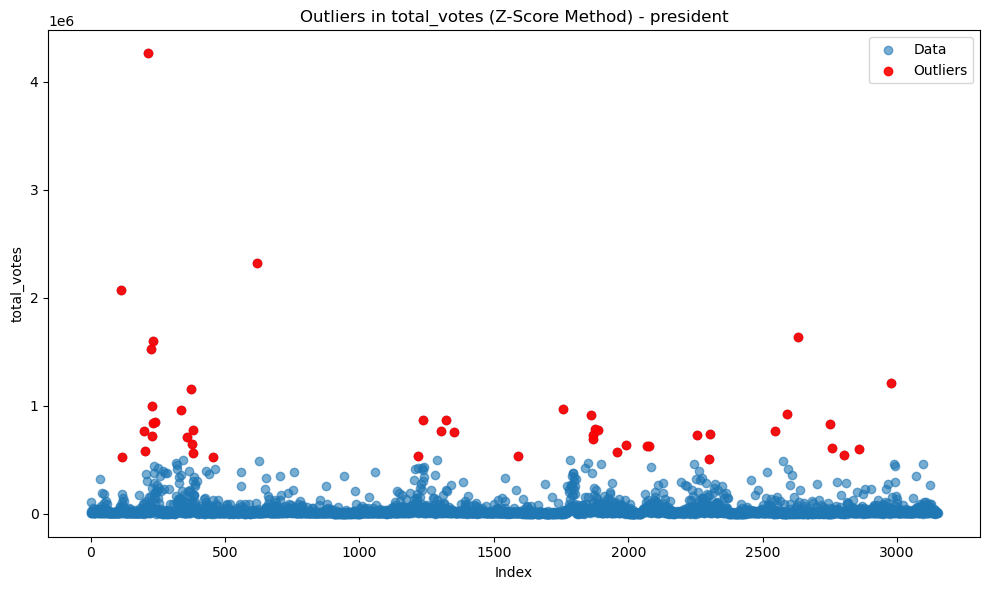

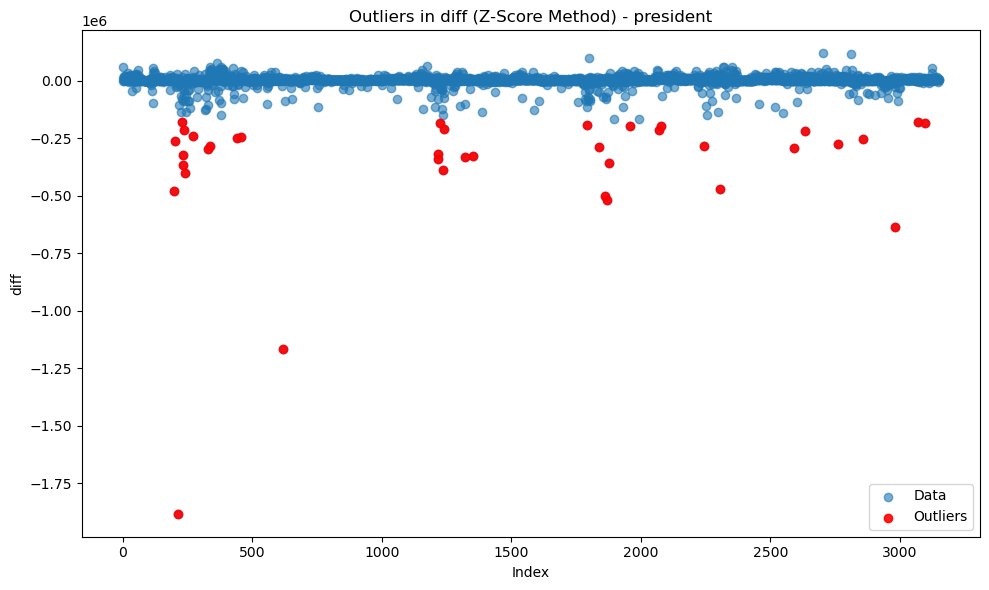

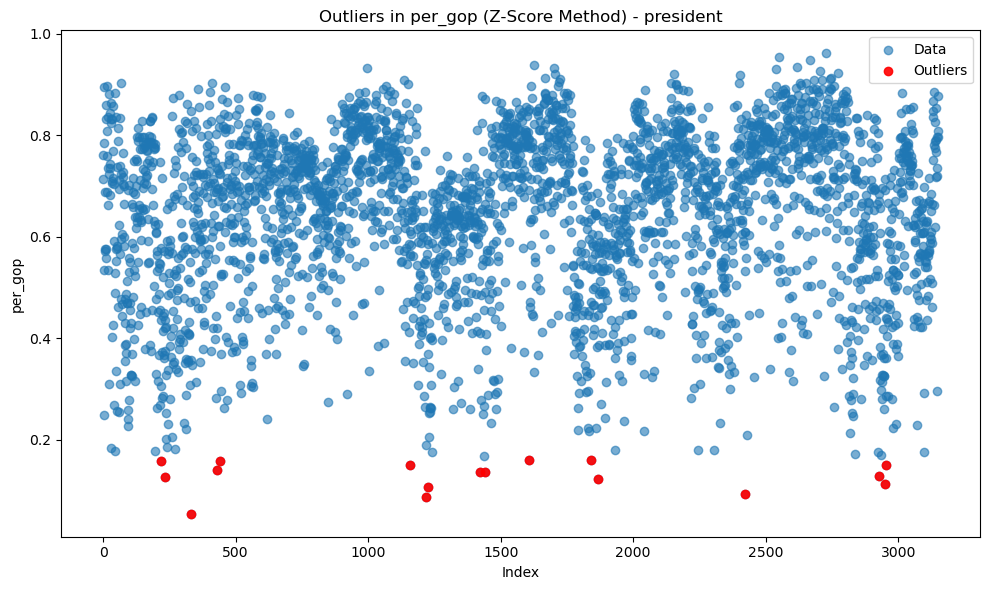

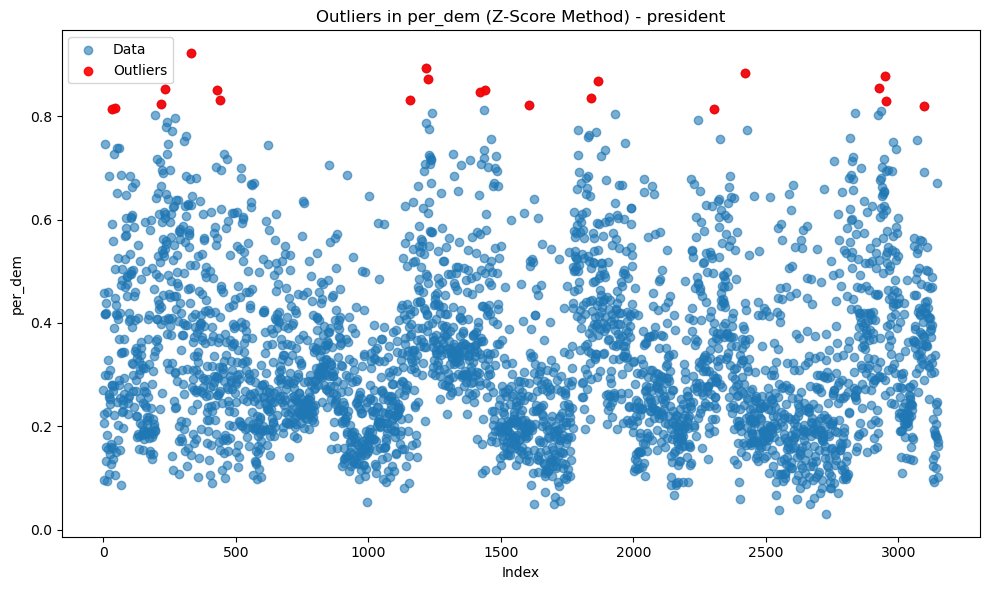

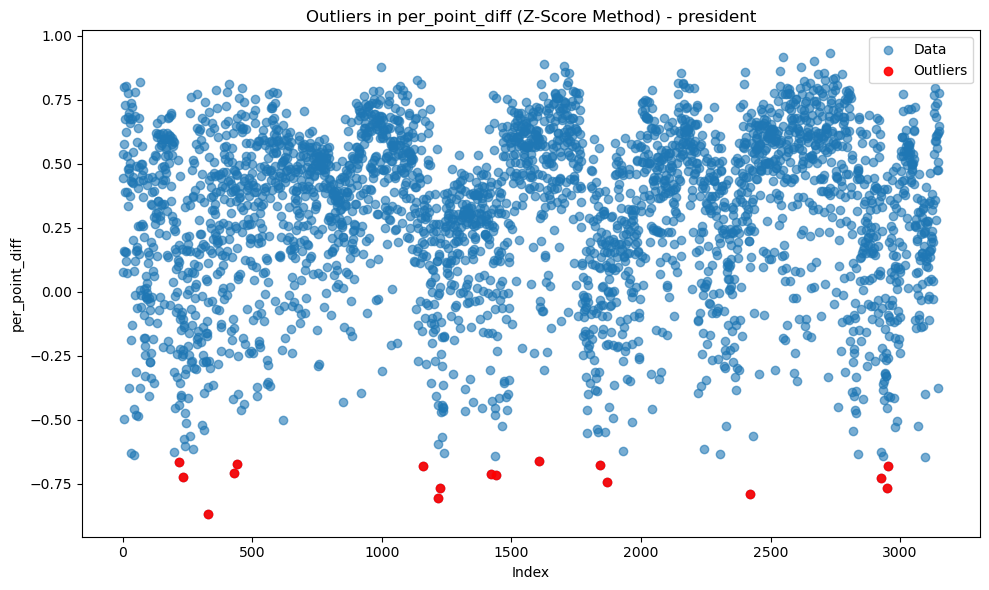


### Analyzing Outliers for presidential_re Dataset Using Z-Score ###


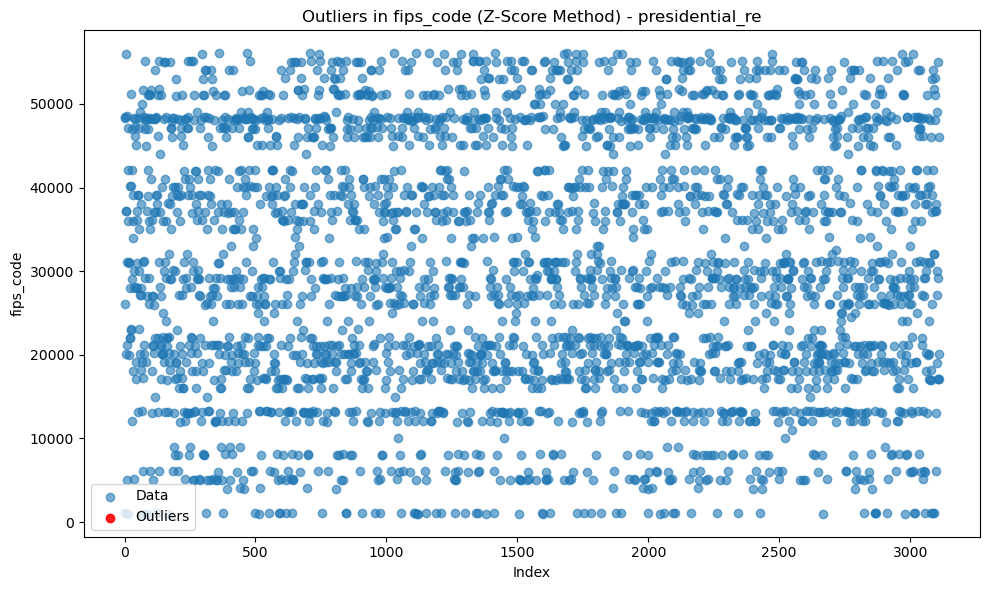

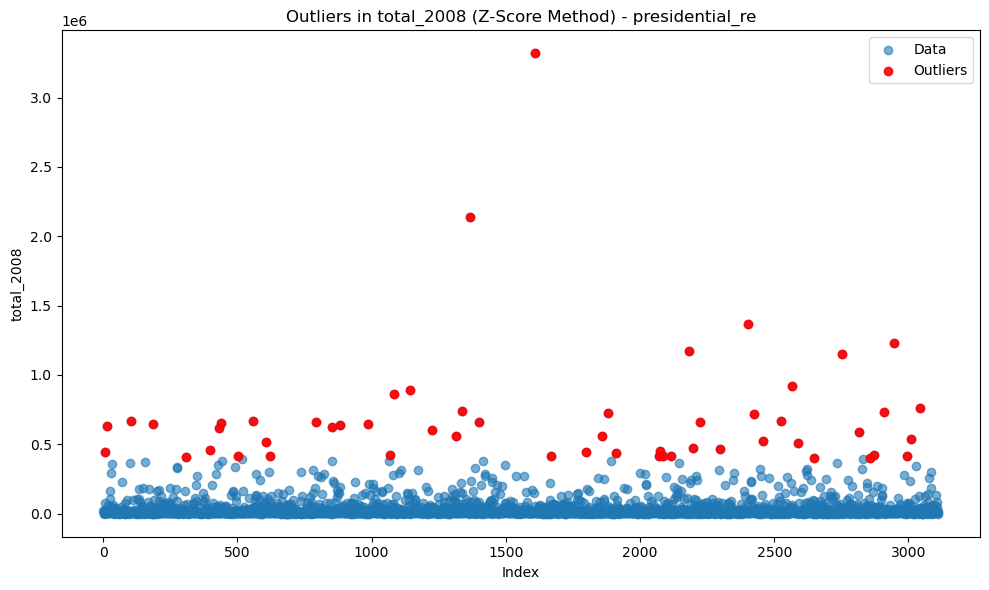

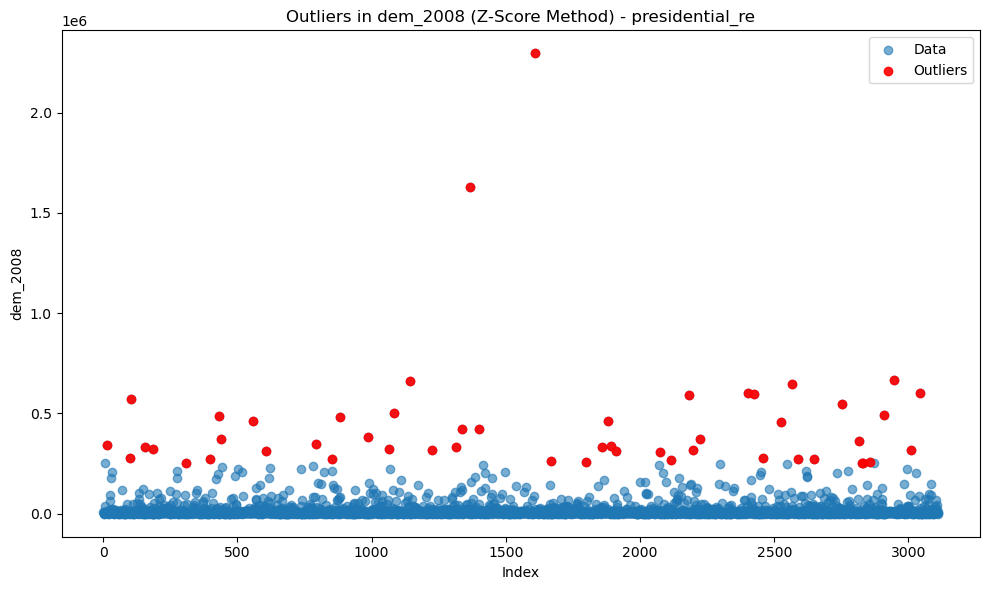

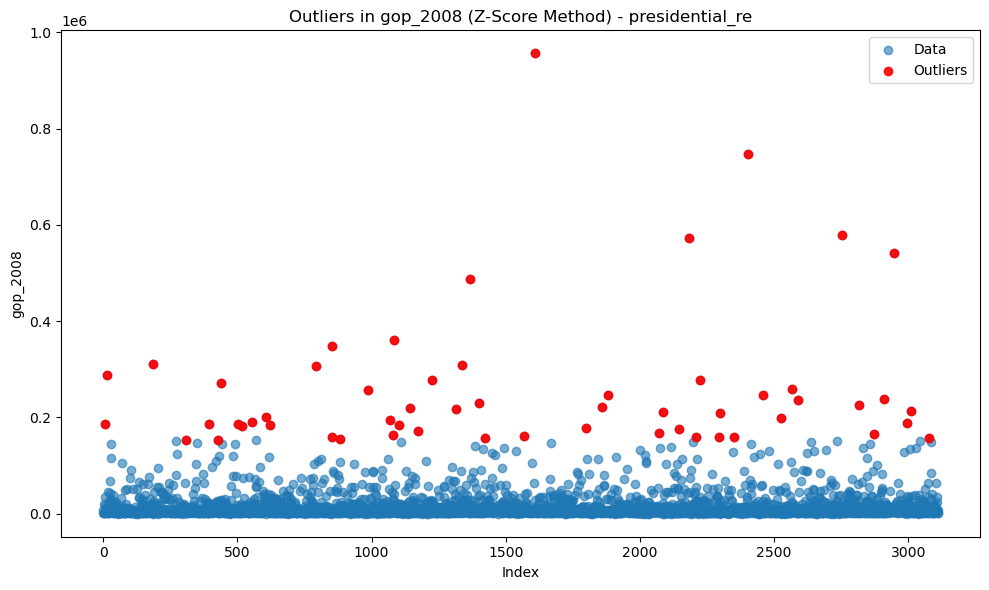

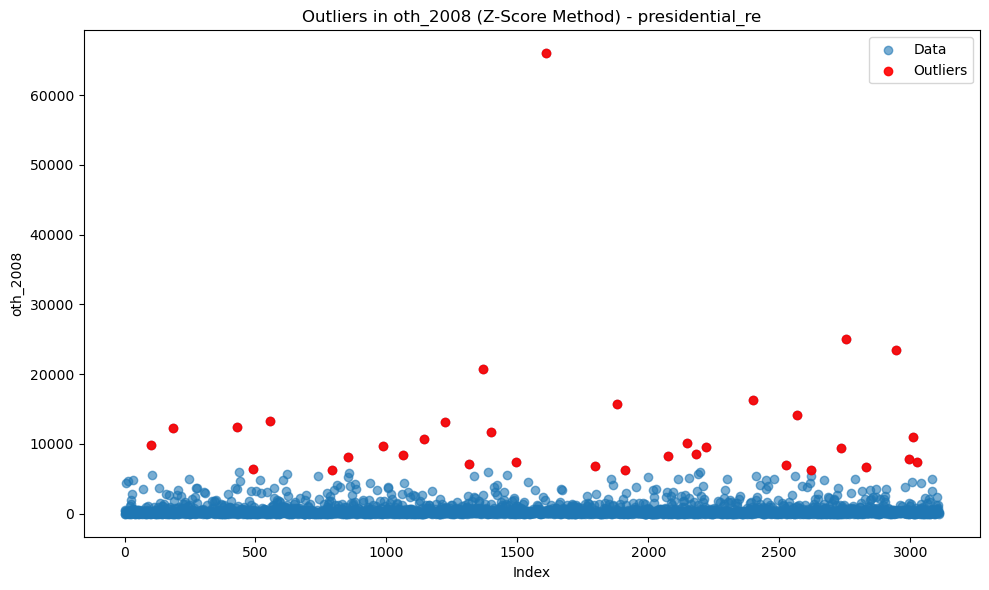

...

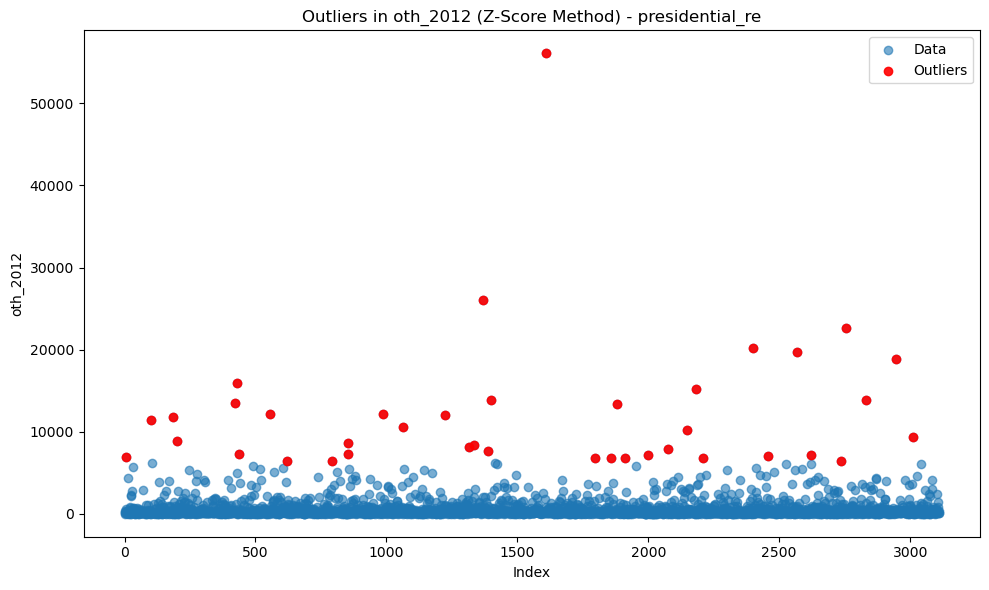

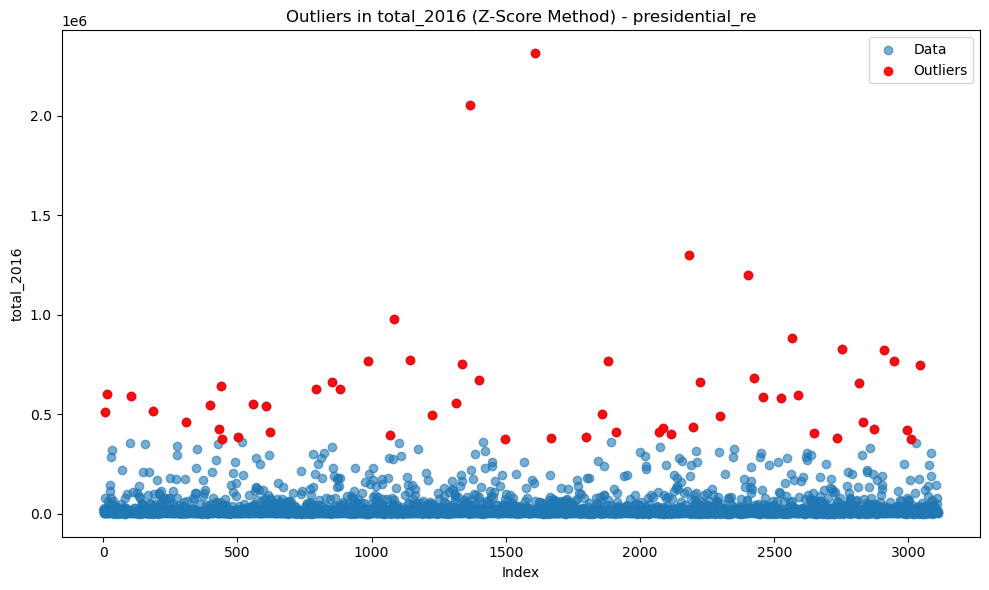

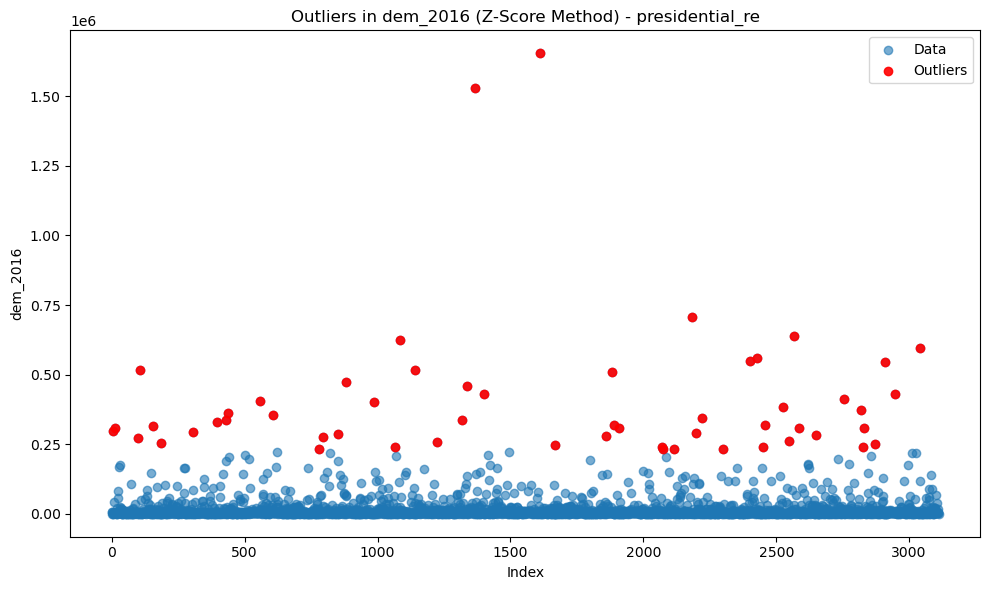

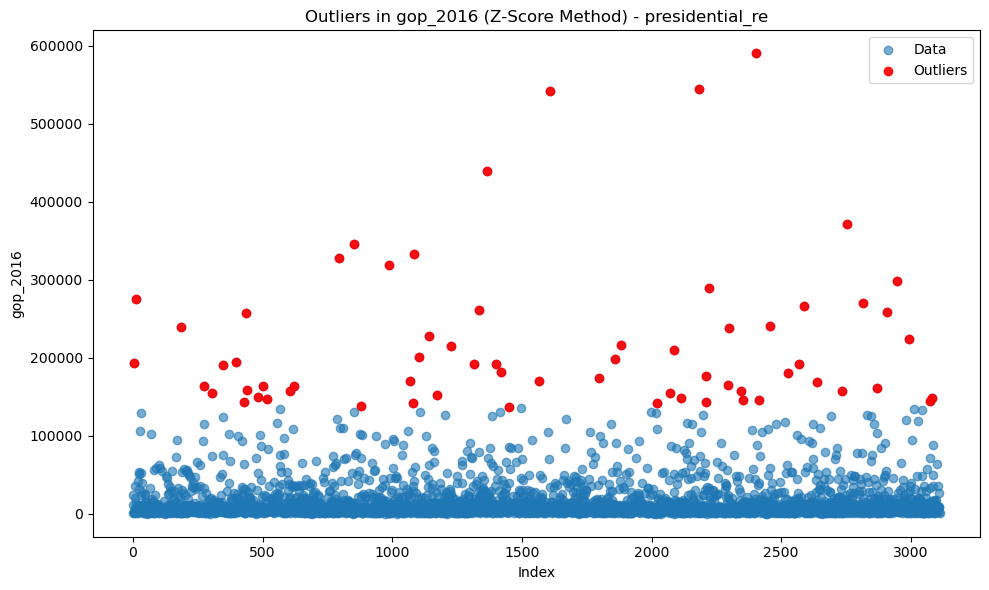

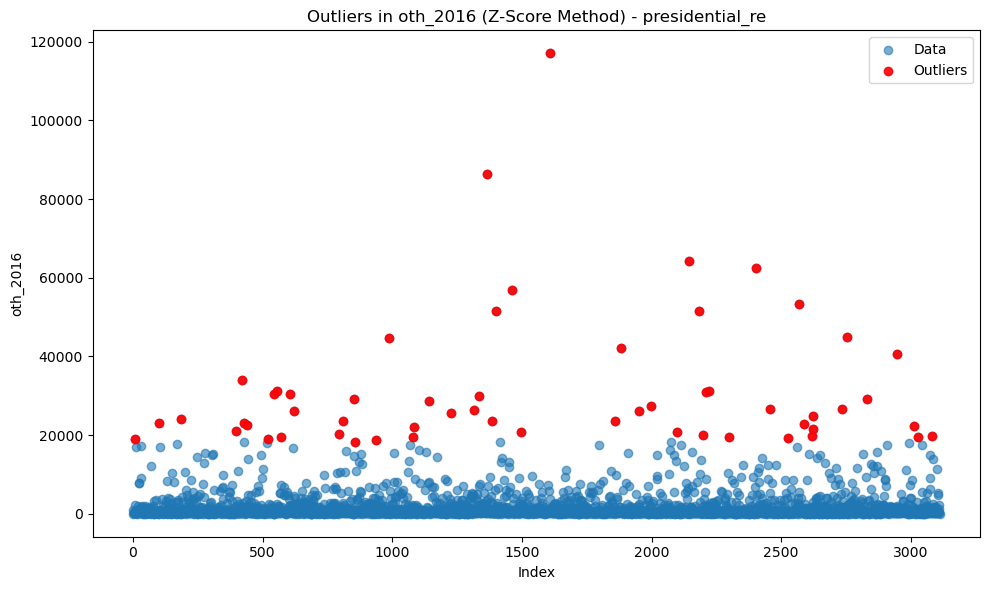


### Analyzing Outliers for unemployment_income Dataset Using Z-Score ###


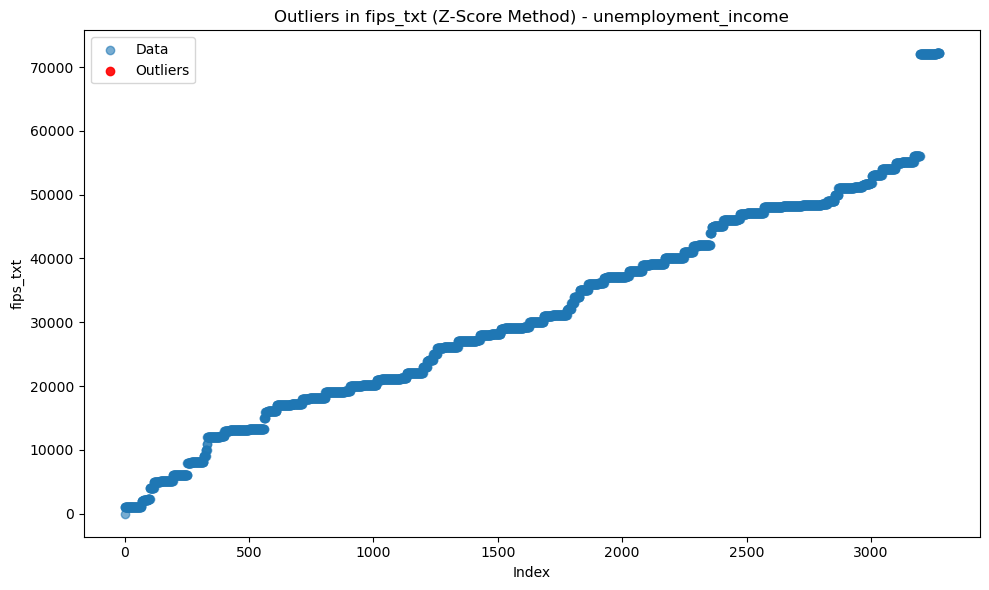

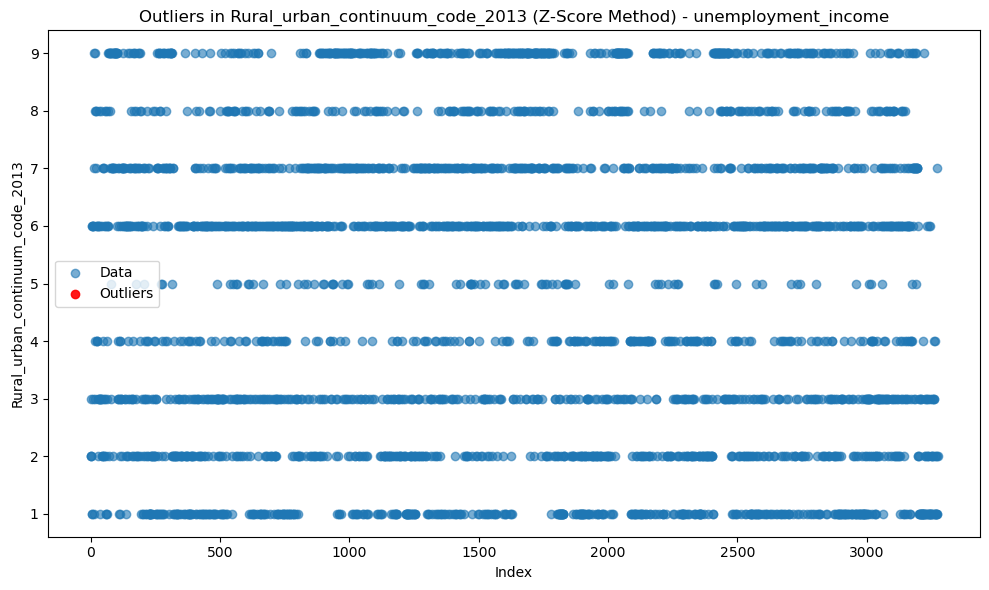

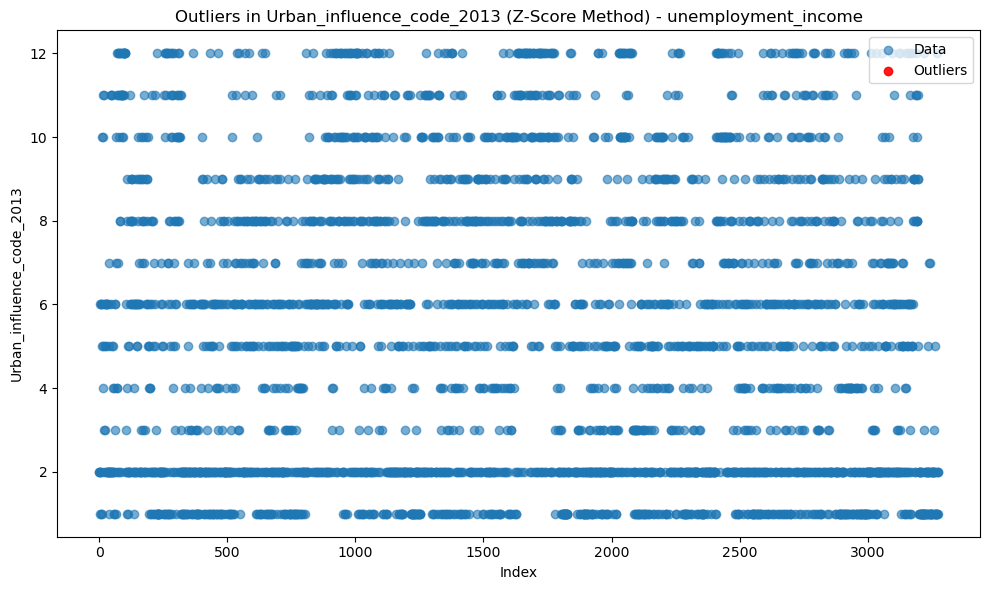

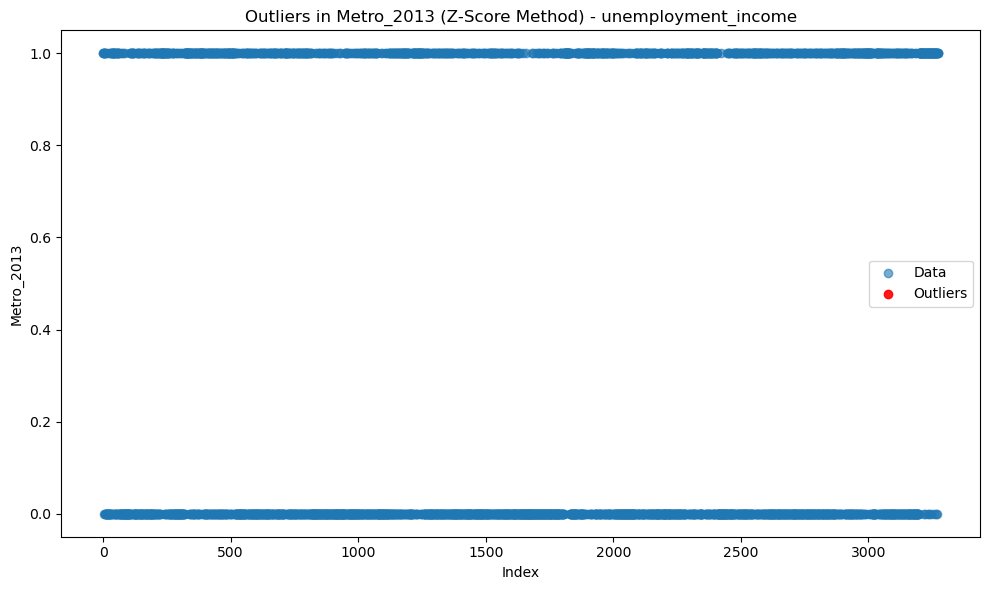

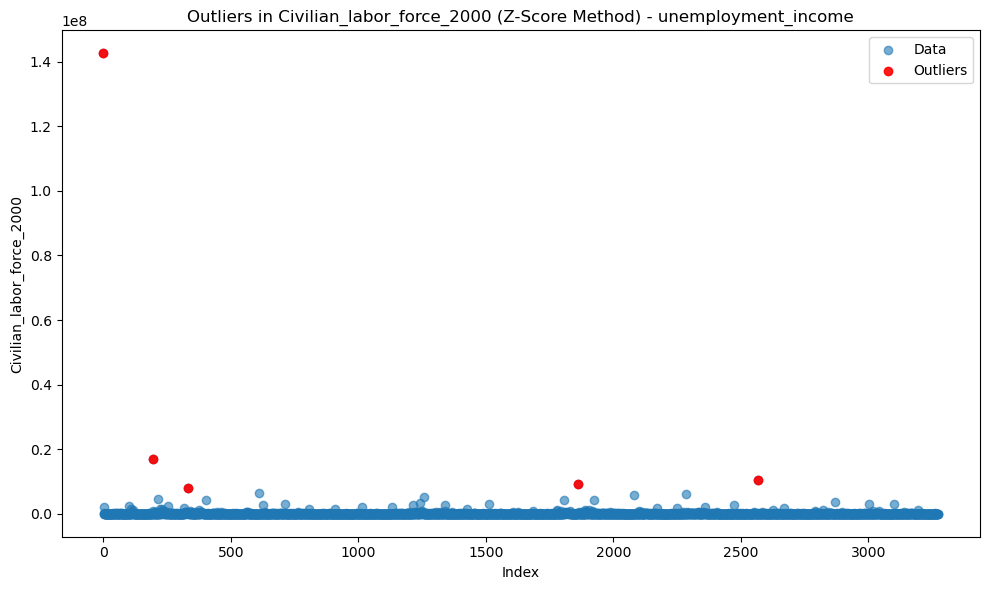

...

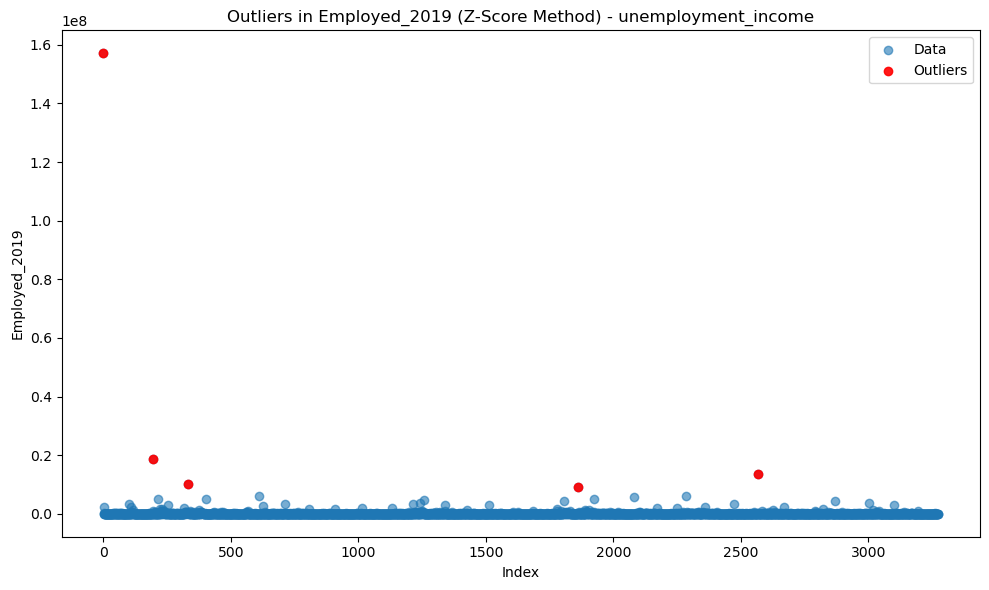

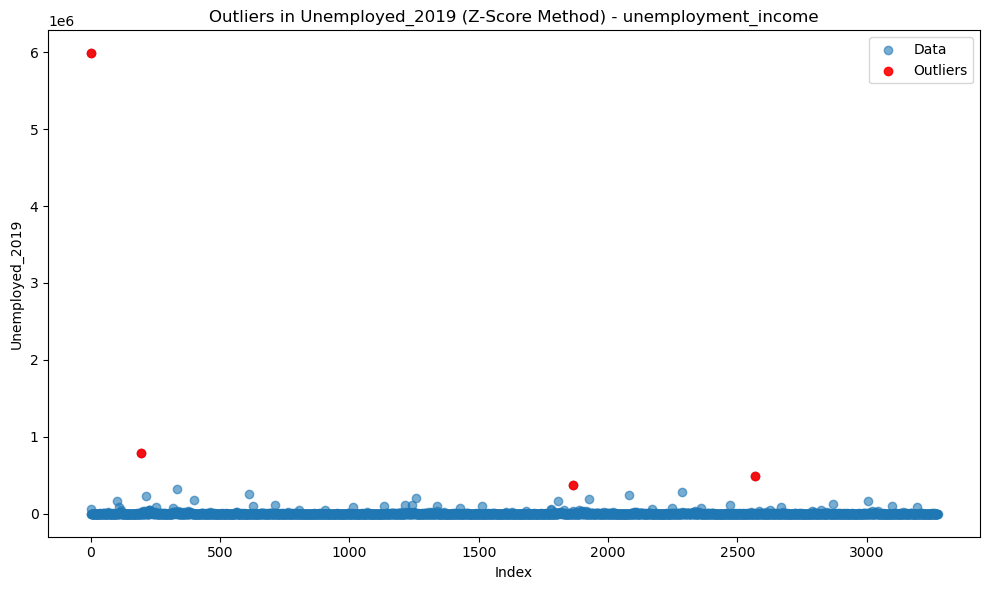

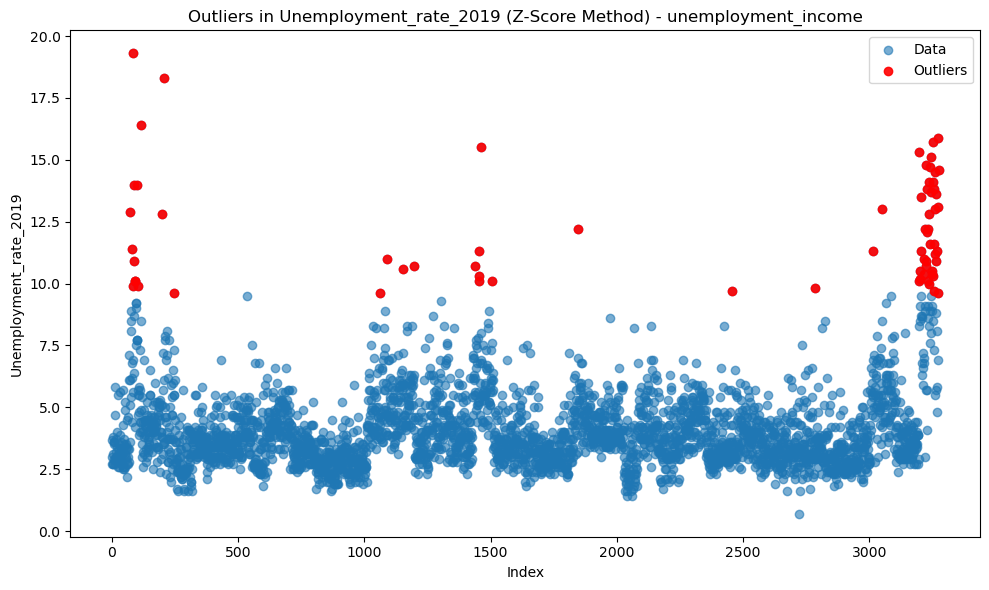

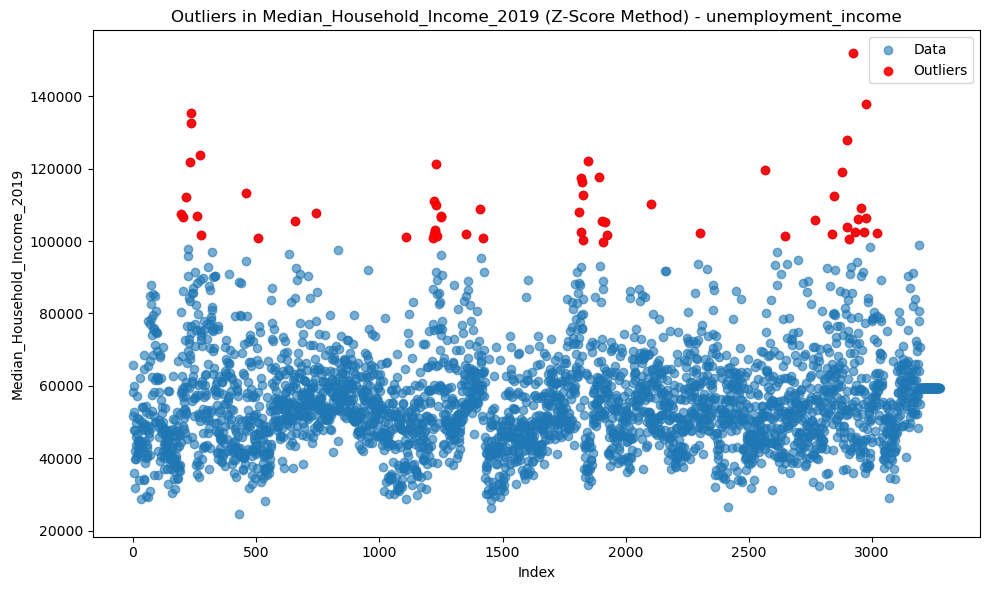

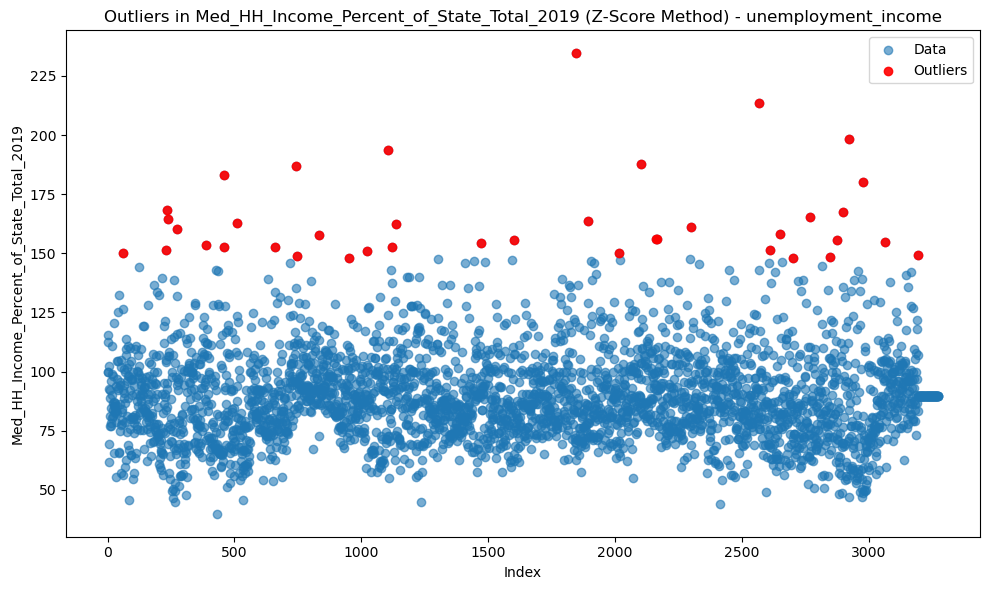


### Outlier Summary ###

education:
  - FIPS Code: 0 outliers
  - 2003 Rural-urban Continuum Code: 0 outliers
  - 2003 Urban Influence Code: 0 outliers
  - 2013 Rural-urban Continuum Code: 0 outliers
  - 2013 Urban Influence Code: 0 outliers
  - Less than a high school diploma, 1970: 6 outliers
  - High school diploma only, 1970: 6 outliers
  - Some college (1-3 years), 1970: 5 outliers
  - Four years of college or higher, 1970: 3 outliers
  - Percent of adults with less than a high school diploma, 1970: 3 outliers
  - Percent of adults with a high school diploma only, 1970: 2 outliers
  - Percent of adults completing some college (1-3 years), 1970: 21 outliers
  - Percent of adults completing four years of college or higher, 1970: 60 outliers
  - Less than a high school diploma, 1980: 5 outliers
  - High school diploma only, 1980: 5 outliers
  - Some college (1-3 years), 1980: 4 outliers
  - Four years of college or higher, 1980: 4 outliers
  - Percent of adults with less than a high

In [80]:


# Dictionnaire des fichiers à analyser
files = {
    "education": "clean/education_clean.csv",
    "population": "clean/population_clean.csv",
    "poverty": "clean/poverty_clean.csv",
    "president": "clean/president_clean.csv",
    "presidential_re": "clean/presidential_re_clean.csv",
    "unemployment_income": "clean/unemployment_income_clean.csv"
}

# Charger les datasets
datasets = {name: pd.read_csv(path) for name, path in files.items()}

# Fonction pour analyser les outliers avec Z-score et générer des visualisations
def analyze_outliers_with_zscore(df, title):
    print(f"\n### Analyzing Outliers for {title} Dataset Using Z-Score ###")
    numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns
    
    outliers_summary = {}
    
    for col in numerical_columns:
        # Calcul des Z-scores
        z_scores = zscore(df[col], nan_policy='omit')
        outliers = (abs(z_scores) > 3)
        outlier_count = outliers.sum()
        outliers_summary[col] = outlier_count
        
        # Visualisation : Scatter plot avec les outliers en rouge
        plt.figure(figsize=(10, 6))
        plt.scatter(range(len(df[col])), df[col], label='Data', alpha=0.6)
        plt.scatter(df.index[outliers], df[col][outliers], color='red', label='Outliers', alpha=0.9)
        plt.title(f"Outliers in {col} (Z-Score Method) - {title}")
        plt.xlabel("Index")
        plt.ylabel(col)
        plt.legend()
        plt.tight_layout()
        plt.show()
    
    return outliers_summary

# Analyse des outliers et visualisations pour chaque dataset
outlier_results = {}
for name, df in datasets.items():
    outlier_results[name] = analyze_outliers_with_zscore(df, name)

# Résumé des résultats
print("\n### Outlier Summary ###")
for dataset, summary in outlier_results.items():
    print(f"\n{dataset}:")
    for col, count in summary.items():
        print(f"  - {col}: {count} outliers")


### Interprétation des Résultats de l’Analyse des Outliers

L'analyse a révélé la présence d'outliers dans plusieurs colonnes de notre datasets. Voici une interprétation détaillée des résultats et des recommandations pour leur gestion :

---

#### **1. Dataset: Education**
- **Colonnes principales concernées par les outliers :**
  - `Percent of adults completing four years of college or higher, 1970`: 60 outliers.
  - `Percent of adults with a bachelor's degree or higher, 2000`: 66 outliers.
  - `Percent of adults with less than a high school diploma, 2015-19`: 32 outliers.

- **Interprétation :**
  - Les outliers dans ces colonnes peuvent correspondre à des régions ayant des niveaux d’éducation exceptionnellement hauts ou bas.
  - Ces outliers reflètent probablement des particularités géographiques ou socio-économiques et ne devraient pas être supprimés sans analyse contextuelle.

- **Recommandation :**
  - Conserver ces valeurs pour les analyses géographiques ou socio-économiques, mais utiliser des transformations log ou une normalisation pour réduire leur impact dans les modèles.

---

#### **2. Dataset: Population**
- **Colonnes principales concernées par les outliers :**
  - `DOMESTIC_MIG_2018`: 32 outliers.
  - `NET_MIG_2019`: 17 outliers.
  - `R_INTERNATIONAL_MIG_2019`: 68 outliers.

- **Interprétation :**
  - Ces colonnes montrent des flux de migration internes et internationaux. Les outliers peuvent représenter des régions spécifiques avec des taux de migration exceptionnels (par exemple, grandes villes ou zones frontalières).

- **Recommandation :**
  - Effectuer une analyse géographique pour valider la pertinence de ces valeurs avant de décider de les conserver ou de les ajuster.

---

#### **3. Dataset: Poverty**
- **Colonnes principales concernées par les outliers :**
  - `PCTPOVALL_2019` (pourcentage de pauvreté globale) : 45 outliers.
  - `MEDHHINC_2019` (revenu médian par ménage) : 58 outliers.

- **Interprétation :**
  - Ces colonnes mettent en évidence des régions avec des taux de pauvreté très élevés ou des revenus médians exceptionnellement bas.
  - Cela pourrait être dû à des régions rurales, zones économiquement défavorisées, ou erreurs de mesure.

- **Recommandation :**
  - Conserver les outliers après validation car ils représentent des caractéristiques importantes pour l’analyse de la pauvreté.

---

#### **4. Dataset: President**
- **Colonnes principales concernées par les outliers :**
  - `votes_gop`: 53 outliers.
  - `votes_dem`: 49 outliers.

- **Interprétation :**
  - Les outliers représentent probablement des comtés ayant un nombre de votes exceptionnellement élevé, par exemple, dans les grandes zones urbaines.

- **Recommandation :**
  - Conserver ces outliers pour refléter correctement les distributions de votes. Appliquer des transformations log si nécessaire.

---

#### **5. Dataset: Presidential Re**
- **Colonnes principales concernées par les outliers :**
  - `gop_2016`: 65 outliers.
  - `dem_2016`: 55 outliers.

- **Interprétation :**
  - Ces outliers représentent les régions avec un soutien massif pour un parti spécifique.

- **Recommandation :**
  - Conserver les outliers car ils sont informatifs dans une analyse politique ou électorale.

---

#### **6. Dataset: Unemployment and Income**
- **Colonnes principales concernées par les outliers :**
  - `Unemployment_rate_2007`: 77 outliers.
  - `Median_Household_Income_2019`: 58 outliers.

- **Interprétation :**
  - Les taux de chômage et les revenus médians montrent des régions affectées par des événements économiques exceptionnels (crises ou prospérité inhabituelle).

- **Recommandation :**
  - Conserver ces valeurs tout en utilisant des transformations pour limiter leur influence dans les modèles.

---

### Recommandations Générales pour la Gestion des Outliers

1. **Validation Contextuelle :**
   - Vérifiez si les outliers sont des erreurs de données ou des valeurs légitimes.

2. **Transformations :**
   - Appliquez des transformations logarithmiques ou Box-Cox pour réduire l’influence des outliers dans les modèles.

3. **Suppression Conditionnelle :**
   - Supprimez uniquement les outliers qui sont des erreurs manifestes ou qui ne reflètent pas des phénomènes réels.

4. **Analyse Approfondie :**
   - Pour des études spécifiques (par exemple, sur la pauvreté ou la migration), utilisez des modèles robustes capables de gérer les outliers (comme les modèles basés sur des métriques quantiles).

---

In [82]:
# Function to retrieve outliers and their rows for each column using Z-score
def retrieve_outliers_with_zscore(df, title):
    print(f"\n### Retrieving Outliers for {title} Dataset Using Z-Score ###")
    numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns
    outlier_details = {}
    
    for col in numerical_columns:
        z_scores = zscore(df[col], nan_policy='omit')
        outliers = df[(abs(z_scores) > 3)].copy()
        outlier_details[col] = outliers[col]
    
    return outlier_details

# Retrieve outlier details for each dataset
outlier_details_all = {}
for name, df in datasets.items():
    outlier_details_all[name] = retrieve_outliers_with_zscore(df, name)

# Summarize the outliers for each dataset
outlier_details_all



### Retrieving Outliers for education Dataset Using Z-Score ###

### Retrieving Outliers for population Dataset Using Z-Score ###

### Retrieving Outliers for poverty Dataset Using Z-Score ###

### Retrieving Outliers for president Dataset Using Z-Score ###

### Retrieving Outliers for presidential_re Dataset Using Z-Score ###

### Retrieving Outliers for unemployment_income Dataset Using Z-Score ###


{'education': {'FIPS Code': Series([], Name: FIPS Code, dtype: int64),
  '2003 Rural-urban Continuum Code': Series([], Name: 2003 Rural-urban Continuum Code, dtype: float64),
  '2003 Urban Influence Code': Series([], Name: 2003 Urban Influence Code, dtype: float64),
  '2013 Rural-urban Continuum Code': Series([], Name: 2013 Rural-urban Continuum Code, dtype: float64),
  '2013 Urban Influence Code': Series([], Name: 2013 Urban Influence Code, dtype: float64),
  'Less than a high school diploma, 1970': 0       52373312.0
  198      4062367.0
  616      2885938.0
  1869     4932459.0
  2291     3329284.0
  2575     3060636.0
  Name: Less than a high school diploma, 1970, dtype: float64,
  'High school diploma only, 1970': 0       34158051.0
  198      3566578.0
  616      1944720.0
  1869     3249934.0
  2087     2010237.0
  2291     2306108.0
  Name: High school diploma only, 1970, dtype: float64,
  'Some college (1-3 years), 1970': 0       11650730.0
  198      1784772.0
  217       655

In [86]:
import pandas as pd

# Charger le fichier nettoyé
education_path = "clean/education_clean.csv"
education_data = pd.read_csv(education_path)

# 1. Compter les valeurs uniques dans la colonne "State" (sans 'US')
unique_states = education_data["State"].unique()
unique_states_without_us = [state for state in unique_states if state != 'US']
unique_states_count = len(unique_states_without_us)

print(f"Nombre de valeurs uniques (sans 'US') dans 'State': {unique_states_count}")
print(f"Liste des valeurs uniques: {unique_states_without_us}")

# 2. Sélectionner la première ligne pour chaque état unique (sauf 'US')
filtered_data = education_data[education_data["State"] != 'US']
first_rows_per_state = filtered_data.groupby("State").first()

# 3. Faire la somme des valeurs de "Less than a high school diploma, 1970"
total_less_high_school_1970 = first_rows_per_state["Less than a high school diploma, 1970"].sum()

print(f"Somme des valeurs de 'Less than a high school diploma, 1970': {total_less_high_school_1970}")


Nombre de valeurs uniques (sans 'US') dans 'State': 52
Liste des valeurs uniques: ['AL', 'AK', 'AZ', 'AR', 'CA', 'CO', 'CT', 'DE', 'DC', 'FL', 'GA', 'HI', 'ID', 'IL', 'IN', 'IA', 'KS', 'KY', 'LA', 'ME', 'MD', 'MA', 'MI', 'MN', 'MS', 'MO', 'MT', 'NE', 'NV', 'NH', 'NJ', 'NM', 'NY', 'NC', 'ND', 'OH', 'OK', 'OR', 'PA', 'RI', 'SC', 'SD', 'TN', 'TX', 'UT', 'VT', 'VA', 'WA', 'WV', 'WI', 'WY', 'PR']
Somme des valeurs de 'Less than a high school diploma, 1970': 52379343.5


In [87]:

# Charger le fichier nettoyé
education_path = "clean/education_clean.csv"  # Remplacez par le chemin correct vers votre fichier
education_data = pd.read_csv(education_path)

# Filtrer les lignes où le State est 'CA' sauf la ligne 198
filtered_data = education_data[(education_data["State"] == 'CA') & (education_data.index != 198)]

# Calculer la somme des valeurs dans "Less than a high school diploma, 1970"
sum_less_high_school_1970 = filtered_data["Less than a high school diploma, 1970"].sum()

# Résultat
print(f"Somme des valeurs de 'Less than a high school diploma, 1970' pour 'CA' (sauf la ligne 198) : {sum_less_high_school_1970}")


Somme des valeurs de 'Less than a high school diploma, 1970' pour 'CA' (sauf la ligne 198) : 4062367.0


La prmiere valeur de Less than a high school diploma, 1970, celui de US est fausse  
  0       52373312.0    52379343.5
  198      4062367.0    4062367.0
  616      2885938.0
  1869     4932459.0
  2291     3329284.0
  2575     3060636.0

# *Les graphiques*